# 라이브러리

In [11]:
import json, os, random, shutil, platform, yaml
from collections import Counter, defaultdict

import cv2, numpy as np, pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image, ImageDraw, ImageFont

import torch, torchvision
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from torchvision.transforms.functional import to_pil_image
import albumentations as A
from albumentations.pytorch import ToTensorV2

# 재현성

In [12]:
# 재현성
def set_seed(seed=42):
    random.seed(seed); np.random.seed(seed)
    torch.manual_seed(seed); torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = False
    torch.backends.cudnn.benchmark = True  # 이미지엔 대체로 이게 빠름

set_seed()

In [13]:
# 디바이스 설정
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("device: ", device)

device:  cpu


In [4]:
"""

일단 베이스 EDA 코드에서 작업을 진행하였습니다.
좀더 디테일한 EDA와 전처리 작업을 위해 내용 추가를 주로 진행하였으니
참고하시고 작업 이어가시기 바랍니다.
"""

'\n\n일단 베이스 EDA 코드에서 작업을 진행하였습니다.\n좀더 디테일한 EDA와 전처리 작업을 위해 내용 추가를 주로 진행하였으니\n참고하시고 작업 이어가시기 바랍니다.\n'

## 경로 설정

In [14]:
# YOLO 폴더 고정(데이터 변환 스킵 시 필수): data_yolo_test 사용
import os
from pathlib import Path

try:
    NB  # 이미 정의됨
except Exception:
    NB = Path.cwd()

# 경로 수정: configs, data, data_yolo_test 기준
CONFIGS_DIR = (NB.parent / 'configs').resolve()
DATA_DIR = (NB.parent / 'data').resolve()
YOLO_ROOT_CAND = (NB.parent / 'data_yolo_test').resolve()

if not YOLO_ROOT_CAND.is_dir():
    raise RuntimeError(f"data_yolo_test 폴더를 찾지 못했습니다: {YOLO_ROOT_CAND}")

yolo_root = str(YOLO_ROOT_CAND)
img_train_dir = os.path.join(yolo_root, 'images', 'train')
img_val_dir   = os.path.join(yolo_root, 'images', 'val')
lbl_train_dir = os.path.join(yolo_root, 'labels', 'train')
lbl_val_dir   = os.path.join(yolo_root, 'labels', 'val')

for p, name in [
    (img_train_dir, 'images/train'),
    (img_val_dir,   'images/val'),
    (lbl_train_dir, 'labels/train'),
    (lbl_val_dir,   'labels/val'),
]:
    if not os.path.isdir(p):
        print(f"[WARN] {name} 없음 → {p}")
    else:
        print(f"[OK] {name} → {p}")
print("configs_dir:", CONFIGS_DIR)
print("data_dir   :", DATA_DIR)
print("yolo_root  :", yolo_root)

[OK] images/train → C:\Users\user\.vscode\pill-snap\data_yolo_test\images\train
[OK] images/val → C:\Users\user\.vscode\pill-snap\data_yolo_test\images\val
[OK] labels/train → C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\train
[OK] labels/val → C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val
configs_dir: C:\Users\user\.vscode\pill-snap\configs
data_dir   : C:\Users\user\.vscode\pill-snap\data
yolo_root  : C:\Users\user\.vscode\pill-snap\data_yolo_test


In [15]:
# 경로설정 (자동 보정 + 어노테이션 경로 오버라이드)
import os
from pathlib import Path

# 노트북 루트 추정
try:
    NB  # 이미 정의됨
except Exception:
    NB = Path.cwd()

# 경로 고정: pill-snap/configs, pill-snap/data, pill-snap/data_yolo_test
CONFIGS_DIR = (NB.parent / 'configs').resolve()
DATA_DIR = (NB.parent / 'data').resolve()
YOLO_ROOT = (NB.parent / 'data_yolo_test').resolve()

# 데이터 루트 및 어노테이션 경로
data_dir = str(DATA_DIR)
train_dir = os.path.join(data_dir, 'train_images')
test_dir = os.path.join(data_dir, 'test_images')

# 어노테이션 경로 오버라이드: pill-snap/data/train_annotations_test 우선
ann_override = DATA_DIR / 'train_annotations_test'
if ann_override.exists():
    annotations_dir = str(ann_override)
    print(f"[INFO] annotations_dir 오버라이드 적용 → {annotations_dir}")
else:
    annotations_dir = os.path.join(data_dir, 'train_annotations')

print('data_dir:', data_dir)
print('exists:', os.path.exists(train_dir), os.path.exists(test_dir), os.path.exists(annotations_dir))

# 이미지 파일 목록
train_images = []
if os.path.exists(train_dir):
    train_images = [f for f in os.listdir(train_dir) if f.lower().endswith(('.png','.jpg','.jpeg'))]
print('이미지 개수:', len(train_images))
print('샘플 3개:', train_images[:3])

# 어노테이션 파일 목록
json_files = []
if os.path.exists(annotations_dir):
    for root, dirs, files in os.walk(annotations_dir):
        for file in files:
            if file.lower().endswith('.json'):
                json_files.append(os.path.join(root, file))
print('어노테이션 파일 개수:', len(json_files))
print('샘플 3개:', json_files[:3])

# json 하나 열어서 구조 확인
if json_files:
    import json, pandas as pd
    with open(json_files[0], 'r', encoding='utf-8') as f:
        data = json.load(f)
    print('keys:', data.keys())
    print('이미지 수:', len(data.get('images', [])))
    print('어노테이션 수:', len(data.get('annotations', [])))
    print('카테고리 수:', len(data.get('categories', [])))
    categories = pd.DataFrame(data.get('categories', []))
    print('유니크 클래스 개수:', categories.shape[0])
    print('클래스 이름 예시:', categories.head())
else:
    print('경고: JSON 어노테이션을 찾지 못했습니다.')

[INFO] annotations_dir 오버라이드 적용 → C:\Users\user\.vscode\pill-snap\data\train_annotations_test
data_dir: C:\Users\user\.vscode\pill-snap\data
exists: True True True
이미지 개수: 1489
샘플 3개: ['K-001900-010224-016551-031705_0_2_0_2_70_000_200.png', 'K-001900-010224-016551-031705_0_2_0_2_75_000_200.png', 'K-001900-010224-016551-031705_0_2_0_2_90_000_200.png']
어노테이션 파일 개수: 5461
샘플 3개: ['C:\\Users\\user\\.vscode\\pill-snap\\data\\train_annotations_test\\K-001900-010224-016551-031705_json\\K-001900\\K-001900-010224-016551-031705_0_2_0_2_70_000_200.json', 'C:\\Users\\user\\.vscode\\pill-snap\\data\\train_annotations_test\\K-001900-010224-016551-031705_json\\K-001900\\K-001900-010224-016551-031705_0_2_0_2_75_000_200.json', 'C:\\Users\\user\\.vscode\\pill-snap\\data\\train_annotations_test\\K-001900-010224-016551-031705_json\\K-001900\\K-001900-010224-016551-031705_0_2_0_2_90_000_200.json']
keys: dict_keys(['images', 'type', 'annotations', 'categories'])
이미지 수: 1
어노테이션 수: 1
카테고리 수: 1
유니크 클래스 개수: 1
클래

## 클래스 갯수 및 bbox 평균

In [16]:
all_classes = []
all_boxes = []

for jf in json_files:
    with open(jf, 'r', encoding='utf-8') as f:
        data = json.load(f)

    # 카테고리 정보
    for cat in data['categories']:
        all_classes.append(cat['name'])

    # 바운딩 박스 정보
    for ann in data['annotations']:
        if 'bbox' in ann and len(ann['bbox']) == 4:
            all_boxes.append(ann['bbox'])


# 클래스 분포
unique_classes = list(set(all_classes))
cls_counter = Counter(all_classes)

print('상위 10개 클래스:', cls_counter.most_common(10))

# 바운딩 박스 크기 분포
widths = [b[2] for b in all_boxes]
heights = [b[3] for b in all_boxes]
print('bbox 평균 크기:', np.mean(widths), np.mean(heights))

상위 10개 클래스: [('기넥신에프정(은행엽엑스)(수출용)', 607), ('일양하이트린정 2mg', 288), ('보령부스파정 5mg', 216), ('뮤테란캡슐 100mg', 215), ('동아가바펜틴정 800mg', 172), ('가바토파정 100mg', 170), ('크레스토정 20mg', 134), ('아토젯정 10/40mg', 134), ('리바로정 4mg', 132), ('리피토정 20mg', 129)]
bbox 평균 크기: 259.2874787572844 288.9420741775756


## 한글 폰트

In [17]:
# VS Code/Windows 한글 폰트 설정 (리눅스 전용 명령 제거)
import os, warnings
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
warnings.filterwarnings(action='ignore')


def setup_korean_font():
    # 후보 폰트 파일(Windows 기본)
    candidates = [
        r"C:\\Windows\\Fonts\\malgun.ttf",      # 맑은 고딕
        r"C:\\Windows\\Fonts\\malgunbd.ttf",    # 맑은 고딕 Bold
        r"C:\\Windows\\Fonts\\batang.ttc",      # 바탕
        r"C:\\Windows\\Fonts\\gulim.ttc",       # 굴림
        r"C:\\Windows\\Fonts\\arial.ttf",       # 대체 영문
    ]
    for p in candidates:
        if os.path.exists(p):
            try:
                fm.fontManager.addfont(p)
            except Exception:
                pass

    # 등록된 폰트 중 선호 순서로 선택
    available = {f.name for f in fm.fontManager.ttflist}
    prefer = ["Malgun Gothic", "맑은 고딕", "Batang", "Gulim", "Arial"]
    chosen = None
    for name in prefer:
        if name in available:
            chosen = name
            break
    if chosen is None:
        # 대체: 현재 기본값 유지
        chosen = plt.rcParams.get('font.family', ['sans-serif'])
        if isinstance(chosen, list) and chosen:
            chosen = chosen[0]
        elif not chosen:
            chosen = 'sans-serif'

    plt.rc('font', family=chosen)
    plt.rcParams['axes.unicode_minus'] = False
    print('Matplotlib font set to:', chosen)


setup_korean_font()

Matplotlib font set to: Malgun Gothic


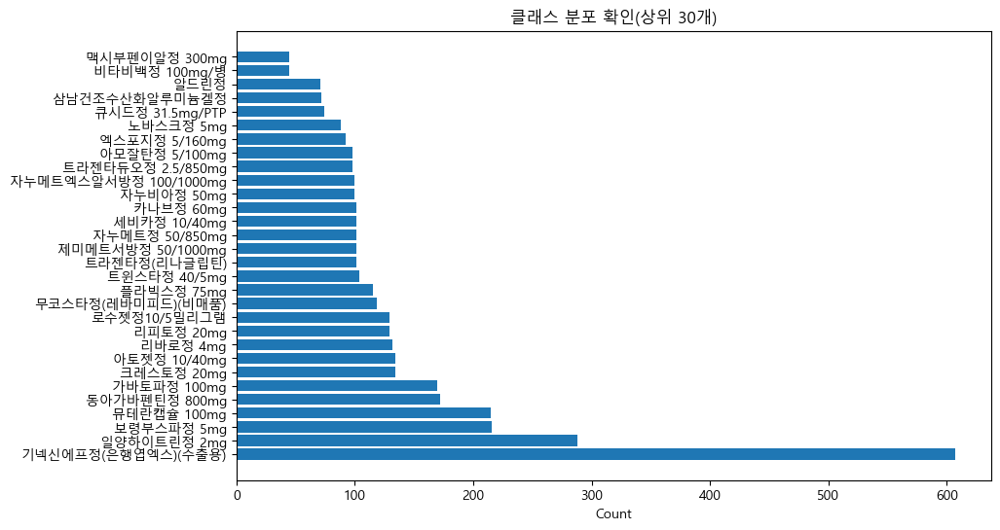

In [18]:
# 클래스 분포 확인(상위 30개)
top_classes = cls_counter.most_common(30)
names, counts = zip(*top_classes)

plt.figure(figsize=(10,6))
plt.barh(names, counts)
plt.xlabel('Count')
plt.title('클래스 분포 확인(상위 30개)')
plt.show()

## Unique Size 확인

In [19]:
sizes = []
for f in os.listdir(train_dir):
    if f.endswith('.png'):
        path = os.path.join(train_dir, f)
        with Image.open(path) as img:
            sizes.append(img.size)  # (width, height)

# 유니크한 사이즈 종류
unique_sizes = Counter(sizes)

print('총 이미지 개수:', len(sizes))
print('유니크 사이즈 개수:', len(unique_sizes))
print('상위 10개 사이즈:', unique_sizes.most_common(10))

총 이미지 개수: 1489
유니크 사이즈 개수: 1
상위 10개 사이즈: [((976, 1280), 1489)]


## bbox 시각화

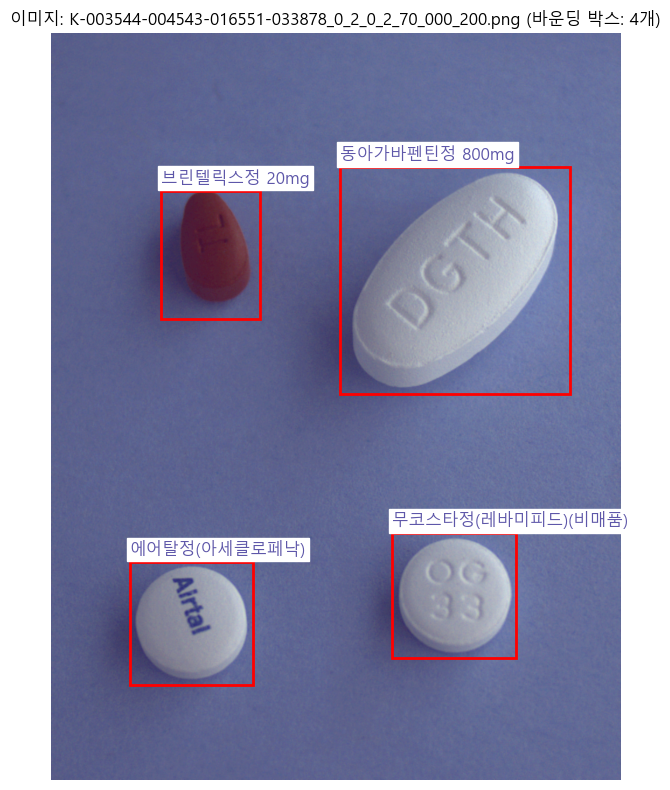

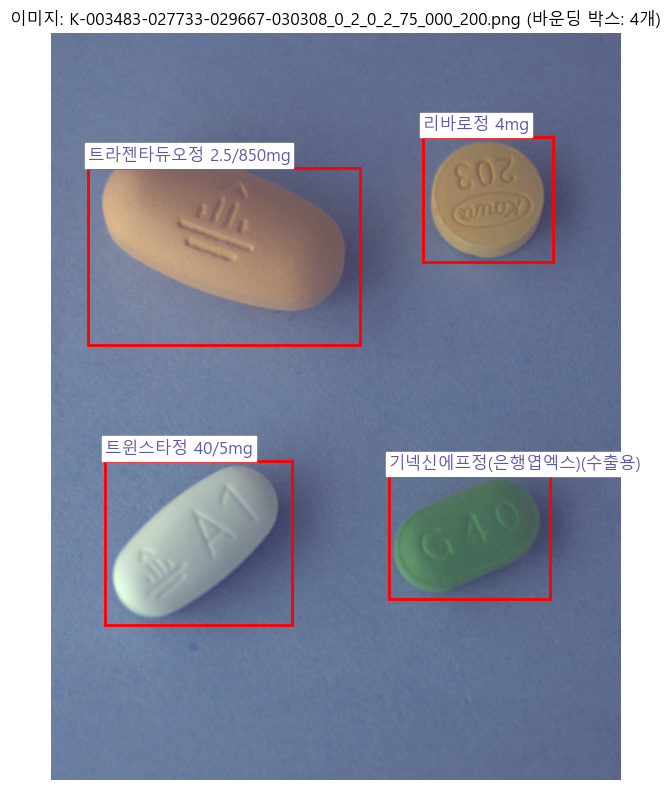

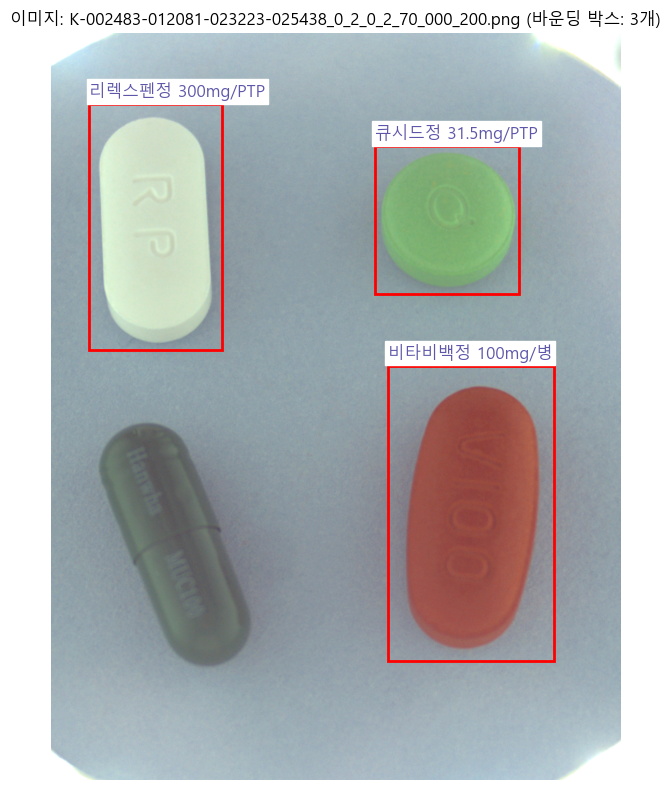

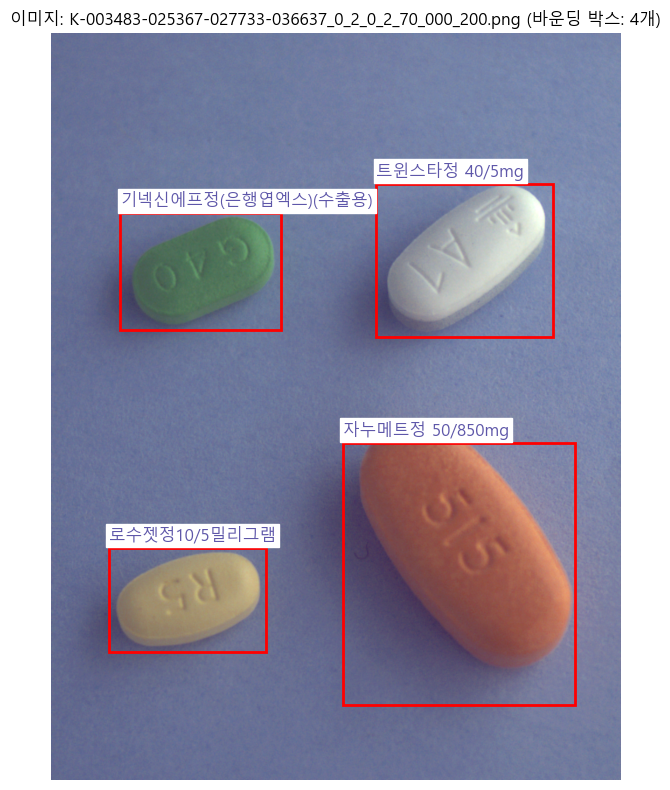

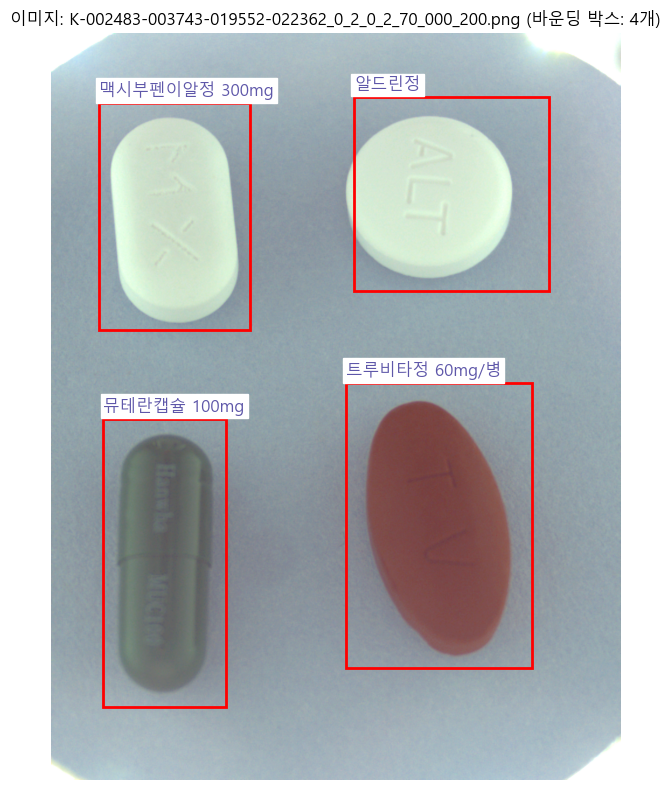

In [20]:
def visualize_pill_dataset(data_dir, json_files, num_samples=5):
    """
    json 파일로 바운딩 박스를 시각화하는 함수

    Args:
        data_dir: 이미지 파일이 있는 디렉토리 경로
        json_files: JSON 파일 경로 리스트
        num_samples: 시각화할 샘플 수 
    """

    annotations = defaultdict(list)

    # 각 JSON 파일 처리 -> dict에 [img file_name]을 key로 {어노테이션정보: [바운드박스]}뽑아서 리스트로 저장하기
    for json_path in json_files:
        with open(json_path, 'r', encoding='utf-8') as f:
            data = json.load(f)

            file_name = data['images'][0]['file_name']
            bbox = data['annotations'][0]['bbox']
            category_name = data['categories'][0]['name']

            annotations[file_name].append({category_name: bbox})

    items_list = list(annotations.items())
    random.shuffle(items_list)

    # 시각화
    for file_name, anno in items_list[:num_samples]:
        image_path = os.path.join(data_dir, file_name)
        img = Image.open(image_path).convert("RGB")

        fig, ax = plt.subplots(1, figsize=(8, 8))
        ax.imshow(img)

        # 모든 바운딩 박스 그리기
        for a in anno:

            label = list(a.keys())[0]
            bbox = list(a.values())[0]

            x, y, width, height = bbox

            # 바운딩 박스 그리기
            rect = patches.Rectangle(
                (x, y), width, height,
                linewidth=2, edgecolor='r', facecolor='none'
            )
            ax.add_patch(rect)

            # 라벨 텍스트
            ax.text(
                x, y - 12, label,
                fontsize=12, color='#5e57a9',
                bbox=dict(facecolor='white', alpha=1, pad=2, edgecolor='White')
            )

        ax.axis('off')
        plt.title(f"이미지: {file_name} (바운딩 박스: {len(anno)}개)")
        plt.tight_layout()
        plt.show()


visualize_pill_dataset(train_dir, json_files, num_samples=5)

In [16]:
"""
일단 코드가 기존 EDA 코드랑 많이 달라졌습니다. 

팀원분들 것을 참고한 것도 있고, 제가 수정한 부분도 있습니다.

이 점 참고해주시면 감사하겠습니다.
"""

'\n일단 코드가 기존 EDA 코드랑 많이 달라졌습니다. \n\n팀원분들 것을 참고한 것도 있고, 제가 수정한 부분도 있습니다.\n\n이 점 참고해주시면 감사하겠습니다.\n'

# 여기부터 다시 작업하기

## bbox 크기

In [21]:
# lbl_train_dir, lbl_val_dir가 정의되지 않아 NameError가 발생한 것입니다.
# 아래 코드를 check_all_labels 함수 위쪽(즉, 함수 정의 전에) 셀에 추가하거나, 함수와 같은 셀의 맨 위에 추가하세요.

import os
from pathlib import Path

# 프로젝트 기준 경로 자동 설정 (pill-snap 구조 기준)
NB = Path.cwd()
YOLO_ROOT = (NB.parent / 'data_yolo_test').resolve()
lbl_train_dir = os.path.join(YOLO_ROOT, 'labels', 'train')
lbl_val_dir   = os.path.join(YOLO_ROOT, 'labels', 'val')

# 경로 확인(없으면 에러)
if not os.path.isdir(lbl_train_dir):
    raise RuntimeError(f"labels/train 폴더를 찾지 못했습니다: {lbl_train_dir}")
if not os.path.isdir(lbl_val_dir):
    raise RuntimeError(f"labels/val 폴더를 찾지 못했습니다: {lbl_val_dir}")

def check_all_labels(label_dir):
    """
    모든 레이블 파일을 검사하여 좌표값이 0~1 범위를 벗어나는지 확인합니다.

    Args:
        label_dir: 레이블 파일이 있는 디렉토리 경로
    """
    # 경로가 없거나 잘못된 경우 경고 후 종료
    if not label_dir or not os.path.isdir(label_dir):
        print(f"[ERROR] 레이블 디렉토리 없음: {label_dir}")
        return []

    invalid_labels = []

    # 레이블 파일 목록 가져오기
    label_files = [f for f in os.listdir(label_dir) if f.endswith('.txt')]

    for label_file in label_files:
        label_path = os.path.join(label_dir, label_file)

        # 레이블 파일 읽기
        try:
            with open(label_path, 'r', encoding='utf-8') as f:
                labels = f.readlines()
        except Exception as e:
            print(f"[ERROR] 파일 열기 실패: {label_path} ({e})")
            continue

        for line_num, label in enumerate(labels, 1):
            parts = label.strip().split()
            if len(parts) == 5:
                try:
                    class_id = int(parts[0])
                    x_center = float(parts[1])
                    y_center = float(parts[2])
                    width = float(parts[3])
                    height = float(parts[4])

                    # 좌표가 0~1 범위를 벗어나는지 확인
                    if (x_center < 0 or x_center > 1 or
                        y_center < 0 or y_center > 1 or
                        width < 0 or width > 1 or
                        height < 0 or height > 1):
                        invalid_labels.append((label_file, line_num, class_id, x_center, y_center, width, height))
                except ValueError:
                    # 숫자로 변환할 수 없는 경우
                    invalid_labels.append((label_file, line_num, "형식 오류", parts))
            else:
                # 형식이 맞지 않는 경우 (항목이 5개가 아님)
                invalid_labels.append((label_file, line_num, "항목 수 오류", parts))

    # 결과 출력
    if invalid_labels:
        print(f"=== 잘못된 형식의 레이블 ({len(invalid_labels)}개 발견) ===")
        for label_file, line_num, *error_info in invalid_labels:
            print(f"파일: {label_file}, 라인: {line_num}, 오류: {error_info}")
        return invalid_labels
    else:
        print("모든 레이블이 올바른 형식입니다.")
        return []

# 사용 예시 (경로가 없으면 자동으로 경고 출력)
invalid_boxes = check_all_labels(lbl_train_dir)
invalid_boxes = check_all_labels(lbl_val_dir)

=== 잘못된 형식의 레이블 (2개 발견) ===
파일: K-003351-016262-018357_0_2_0_2_75_000_200.txt, 라인: 3, 오류: [43, 6.887807, 0.611328, 0.318648, 0.246094]
파일: K-003544-004543-012247-016551_0_2_0_2_70_000_200.txt, 라인: 1, 오류: [63, 0.780225, 7.029297, 0.222336, 0.169531]
모든 레이블이 올바른 형식입니다.


## bbox 잘못된 좌표

In [22]:
def check_overlapping_boxes(label_dir, iou_threshold=0.5):
    """
    같은 이미지 내에서 바운딩 박스끼리 겹침이 있는지 확인합니다.

    Args:
        label_dir: 레이블 파일이 있는 디렉토리 경로
        iou_threshold: 겹침으로 판단할 IoU 임계값 (기본값: 0.5)
    """
    overlapping_boxes = []

    # 레이블 파일 목록 가져오기
    label_files = [f for f in os.listdir(label_dir) if f.endswith('.txt')]

    for label_file in label_files:
        label_path = os.path.join(label_dir, label_file)

        # 레이블 파일 읽기
        with open(label_path, 'r') as f:
            labels = f.readlines()

        boxes = []
        for line in labels:
            parts = line.strip().split()
            if len(parts) == 5:
                try:
                    class_id = int(parts[0])
                    x_center = float(parts[1])
                    y_center = float(parts[2])
                    width = float(parts[3])
                    height = float(parts[4])

                    # YOLO 형식(x_center, y_center, width, height)에서
                    # 좌표 형식(x1, y1, x2, y2)으로 변환
                    x1 = x_center - width / 2
                    y1 = y_center - height / 2
                    x2 = x_center + width / 2
                    y2 = y_center + height / 2

                    boxes.append((class_id, x1, y1, x2, y2))
                except ValueError:
                    continue

        # 같은 이미지 내의 모든 바운딩 박스 쌍에 대해 IoU 계산
        for i in range(len(boxes)):
            for j in range(i+1, len(boxes)):
                box1 = boxes[i]
                box2 = boxes[j]

                # IoU 계산
                # 두 박스의 교집합 영역
                x_left = max(box1[1], box2[1])
                y_top = max(box1[2], box2[2])
                x_right = min(box1[3], box2[3])
                y_bottom = min(box1[4], box2[4])

                # 교집합 영역이 있는지 확인
                if x_right > x_left and y_bottom > y_top:
                    intersection_area = (x_right - x_left) * (y_bottom - y_top)

                    # 각 박스의 면적
                    box1_area = (box1[3] - box1[1]) * (box1[4] - box1[2])
                    box2_area = (box2[3] - box2[1]) * (box2[4] - box2[2])

                    # IoU 계산
                    union_area = box1_area + box2_area - intersection_area
                    iou = intersection_area / union_area

                    # 임계값 이상이면 겹침으로 판단
                    if iou >= iou_threshold:
                        overlapping_boxes.append((
                            label_file,
                            box1[0], # class_id 1
                            box2[0], # class_id 2
                            iou,
                            (box1[1], box1[2], box1[3], box1[4]),
                            (box2[1], box2[2], box2[3], box2[4])
                        ))

    # 결과 출력
    if overlapping_boxes:
        print(f"=== 겹치는 바운딩 박스 ({len(overlapping_boxes)}개 발견) ===")
        for file, class1, class2, iou, box1, box2 in overlapping_boxes:
            print(f"파일: {file}, 클래스: {class1}와 {class2}, IoU: {iou:.4f}")
        return overlapping_boxes
    else:
        print("겹치는 바운딩 박스가 없습니다.")
        return []

# 사용 예시
overlapping_boxes = check_overlapping_boxes(lbl_train_dir, iou_threshold=0.5)

=== 겹치는 바운딩 박스 (4개 발견) ===
파일: K-003351-003832-029667_0_2_0_2_90_000_200.txt, 클래스: 30와 37, IoU: 1.0000
파일: K-003351-018147-020238_0_2_0_2_90_000_200.txt, 클래스: 29와 34, IoU: 1.0000
파일: K-003351-020238-031863_0_2_0_2_70_000_200.txt, 클래스: 29와 34, IoU: 1.0000
파일: K-003351-020238-031863_0_2_0_2_75_000_200.txt, 클래스: 29와 34, IoU: 1.0000


[OK] images/train → C:\Users\user\.vscode\pill-snap\data_yolo_test\images\train
[OK] images/val → C:\Users\user\.vscode\pill-snap\data_yolo_test\images\val
[OK] labels/train → C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\train
[OK] labels/val → C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val


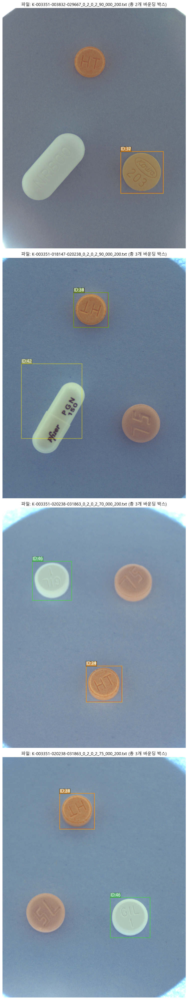

In [23]:
# visualize_specific_overlapping_boxes 실행 전에 아래 코드로 img_train_dir, lbl_train_dir, img_val_dir, lbl_val_dir를 반드시 정의하세요.

import os
from pathlib import Path

NB = Path.cwd()
YOLO_ROOT = (NB.parent / 'data_yolo_test').resolve()
img_train_dir = os.path.join(YOLO_ROOT, 'images', 'train')
img_val_dir   = os.path.join(YOLO_ROOT, 'images', 'val')
lbl_train_dir = os.path.join(YOLO_ROOT, 'labels', 'train')
lbl_val_dir   = os.path.join(YOLO_ROOT, 'labels', 'val')

# 경로 확인(없으면 에러)
for d, name in [
    (img_train_dir, 'images/train'),
    (img_val_dir,   'images/val'),
    (lbl_train_dir, 'labels/train'),
    (lbl_val_dir,   'labels/val'),
]:
    if not os.path.isdir(d):
        print(f"[WARN] {name} 없음 → {d}")
    else:
        print(f"[OK] {name} → {d}")

def visualize_specific_overlapping_boxes(image_dir, label_dir, overlapping_label_filenames):
    """
    제공된 레이블 파일 이름 목록에 해당하는 이미지와 바운딩 박스를 시각화합니다.

    Args:
        image_dir: 이미지 파일이 있는 디렉토리 경로 (예: 'path/to/your/images')
        label_dir: 레이블 파일이 있는 디렉토리 경로 (예: 'path/to/your/labels')
        overlapping_label_filenames: 시각화할 레이블 파일 이름 리스트 (예: ['K-001900-....txt', ...])
    """

    num_files = len(overlapping_label_filenames)
    if num_files == 0:
        print("시각화할 파일이 없습니다. 목록을 다시 확인해주세요.")
        return

    # 서브플롯 개수를 동적으로 설정
    fig, axes = plt.subplots(num_files, 1, figsize=(8, 10 * num_files))

    # 파일이 하나일 경우 axes가 배열이 아닌 단일 객체로 반환될 수 있으므로 리스트로 감싸줍니다.
    if num_files == 1:
        axes = [axes]

    for idx, label_filename in enumerate(overlapping_label_filenames):
        # 이미지 파일 이름 유추 (레이블 파일 이름에서 확장자만 변경)
        # 일반적인 이미지 확장자를 고려하여 `.jpg`, `.png`, `.jpeg` 순으로 시도합니다.
        base_filename = os.path.splitext(label_filename)[0]
        img_found = False
        img_path = None
        for ext in ['.jpg', '.png', '.jpeg']:
            test_img_path = os.path.join(image_dir, base_filename + ext)
            if os.path.exists(test_img_path):
                img_path = test_img_path
                img_found = True
                break

        if not img_found:
            axes[idx].set_title(f"오류: '{base_filename}'에 해당하는 이미지 파일을 찾을 수 없습니다.", color='red')
            axes[idx].axis('off')
            continue

        label_path = os.path.join(label_dir, label_filename)

        # 이미지 로드
        img = cv2.imread(img_path)
        if img is None:
            axes[idx].set_title(f"오류: '{img_path}' 이미지를 로드할 수 없습니다.", color='red')
            axes[idx].axis('off')
            continue

        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w, _ = img.shape

        # 레이블 파일 로드
        if not os.path.exists(label_path):
            axes[idx].imshow(img)
            axes[idx].set_title(f"'{label_filename}' - 레이블 파일을 찾을 수 없습니다.")
            axes[idx].axis('off')
            continue

        with open(label_path, 'r') as f:
            labels = f.readlines()

        axes[idx].imshow(img)
        axes[idx].set_title(f"파일: {label_filename} (총 {len(labels)}개 바운딩 박스)")
        axes[idx].axis('off') # 축 정보 숨기기

        # 각 바운딩 박스 그리기
        for line_num, label_line in enumerate(labels):
            parts = label_line.strip().split()
            if len(parts) == 5:
                try:
                    class_id = int(parts[0])
                    x_center_norm = float(parts[1])
                    y_center_norm = float(parts[2])
                    width_norm = float(parts[3])
                    height_norm = float(parts[4])

                    # 정규화된 좌표를 실제 픽셀 좌표로 변환
                    x_center = x_center_norm * w
                    y_center = y_center_norm * h
                    bbox_width = width_norm * w
                    bbox_height = height_norm * h

                    # 바운딩 박스의 좌상단 좌표
                    x1 = int(x_center - bbox_width / 2)
                    y1 = int(y_center - bbox_height / 2)

                    # 겹치는 바운딩 박스를 더 명확하게 시각화하기 위해
                    # 각 박스에 고유한 색상 또는 패턴을 적용할 수 있습니다.
                    # 여기서는 간단하게 선의 두께와 투명도를 조절해봅니다.

                    # 무작위 색상 대신 예측 가능한 색상을 사용 (겹쳐도 알아보기 쉽게)
                    colors = plt.cm.get_cmap('hsv', 256) # 256가지 색상 맵
                    color = colors(line_num * 40 % 256) # 인덱스에 따라 다른 색상 부여

                    rect = plt.Rectangle((x1, y1), bbox_width+line_num, bbox_height+line_num,
                                         fill=False, edgecolor=color, linewidth=2 , alpha=0.4)
                    axes[idx].add_patch(rect)
                    axes[idx].text(x1, y1 - 5, f"ID:{class_id}",
                                 color='white', fontsize=13,
                                 bbox=dict(facecolor=color, alpha=0.3, pad=0.5))
                except ValueError:
                    axes[idx].text(10, 30 + line_num*20, f"레이블 파싱 오류 (라인 {line_num+1})", color='yellow', fontsize=10, backgroundcolor='red')
            else:
                axes[idx].text(10, 30 + line_num*20, f"레이블 형식 오류 (라인 {line_num+1}, {len(parts)}개 항목)", color='yellow', fontsize=10, backgroundcolor='red')

    plt.tight_layout()
    plt.show()




overlapping_boxes_filenames = [item[0] for item in overlapping_boxes]


#visualize_specific_overlapping_boxes(img_val_dir, lbl_val_dir, overlapping_boxes_filenames)
visualize_specific_overlapping_boxes(img_train_dir, lbl_train_dir, overlapping_boxes_filenames)

In [24]:
def pixel_to_normalized(x1, y1, x2, y2, img_width=976, img_height=1280):
    x_center = (x1 + x2) / 2
    y_center = (y1 + y2) / 2
    width = x2 - x1
    height = y2 - y1

    x_center_norm = x_center / img_width
    y_center_norm = y_center / img_height
    width_norm = width / img_width
    height_norm = height / img_height

    return x_center_norm, y_center_norm, width_norm, height_norm

In [26]:
def change_bbox(lbl_dir, files_to_fix):

    for filename, boxes in files_to_fix.items():

        # 각 파일의 바운딩 박스 정보 순회
        for box_info in boxes:

            label = box_info['label']
            coord = box_info['coord']

            # 수정할 좌표
            new_bbox = {
                "class": label,
                "x_center": coord[0],
                "y_center": coord[1],
                "width": coord[2],
                "height": coord[3]
                }

            # 경로 설정
            lbl_path = os.path.join(lbl_dir, filename)

            try:
                # 1. 어노테이션 파일 읽기
                with open(lbl_path, 'r') as f:
                    lines = f.readlines()

                # 2. 클래스 라벨 수정
                new_lines = []
                existing_labels = set()

                # 기존 라인 읽으며 라벨만 수집
                for line in lines:
                    parts = line.strip().split()
                    existing_labels.add(int(parts[0]))

                # 기존 라인 처리 및 좌표 변경
                for line in lines:
                    parts = line.strip().split()
                    cls = int(parts[0])
                    if label == cls:
                        # 새 좌표로 바꿈
                        new_line = f"{label} {new_bbox['x_center']} {new_bbox['y_center']} {new_bbox['width']} {new_bbox['height']}\n"
                        new_lines.append(new_line)
                    else:
                        new_lines.append(line)

                # 새 라벨 추가가 필요한 경우
                if label not in existing_labels:
                    new_line = f"{label} {new_bbox['x_center']} {new_bbox['y_center']} {new_bbox['width']} {new_bbox['height']}\n"
                    new_lines.append(new_line)

                # 3. 수정 내용을 파일에 덮어쓰기
                with open(lbl_path, 'w') as f:
                    f.writelines(new_lines)

                print(f"'{lbl_path}' 파일 내 {label}번 클래스 바운딩 박스 좌표가 정상적으로 수정됨")

            except FileNotFoundError:
                print(f"'{lbl_path}' 파일이 존재하지 않습니다. 건너뜁니다.")
            except Exception as e:
                print(f"'{lbl_path}' 처리 중 오류 발생: {e}")


In [27]:
files_to_fix = {
    'K-001900-016548-019607-033009_0_2_0_2_70_000_200.txt': [{'label':0, 'coord':pixel_to_normalized(105,868,331,1091)}],
    'K-003351-018147-020238_0_2_0_2_90_000_200.txt': [{'label':72, 'coord':pixel_to_normalized(632,777,838,986)}],
    'K-003351-003832-029667_0_2_0_2_90_000_200.txt': [{'label':7, 'coord':pixel_to_normalized(101,664,442,1023)},
                                                      {'label':49, 'coord':pixel_to_normalized(376,207,553,374)},
                                                    ],
    'K-003351-029667-031863_0_2_0_2_70_000_200.txt': [{'label':49, 'coord':pixel_to_normalized(382,864,553,1039)}],
    'K-003351-020238-031863_0_2_0_2_70_000_200.txt': [{'label':72, 'coord':pixel_to_normalized(593,299,797,504)}],
    'K-003351-016262-018357_0_2_0_2_75_000_200.txt': [{'label':57, 'coord':pixel_to_normalized(578,631,871,933)}],
    'K-003544-004543-012247-016551_0_2_0_2_70_000_200.txt': [{'label':45, 'coord':pixel_to_normalized(151,873,345,1068)},
                                                      {'label':9, 'coord':pixel_to_normalized(127,161,402,585)},
                                                      {'label':24, 'coord':pixel_to_normalized(664,895,862,1094)},
                                                    ],
}

change_bbox(lbl_train_dir, files_to_fix)

'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\train\K-001900-016548-019607-033009_0_2_0_2_70_000_200.txt' 파일 내 0번 클래스 바운딩 박스 좌표가 정상적으로 수정됨
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\train\K-003351-018147-020238_0_2_0_2_90_000_200.txt' 파일 내 72번 클래스 바운딩 박스 좌표가 정상적으로 수정됨
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\train\K-003351-003832-029667_0_2_0_2_90_000_200.txt' 파일 내 7번 클래스 바운딩 박스 좌표가 정상적으로 수정됨
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\train\K-003351-003832-029667_0_2_0_2_90_000_200.txt' 파일 내 49번 클래스 바운딩 박스 좌표가 정상적으로 수정됨
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\train\K-003351-029667-031863_0_2_0_2_70_000_200.txt' 파일 내 49번 클래스 바운딩 박스 좌표가 정상적으로 수정됨
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\train\K-003351-020238-031863_0_2_0_2_70_000_200.txt' 파일 내 72번 클래스 바운딩 박스 좌표가 정상적으로 수정됨
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\train\K-003351-016262-018357_0_2_0_2_75_000_200.txt' 파일 내 57번 클래스 바운딩 박스 좌표가 정상적으로 수정됨
'

In [23]:
overlapping_boxes = check_overlapping_boxes(lbl_train_dir, iou_threshold=0.5)

겹치는 바운딩 박스가 없습니다.


In [28]:
change_bbox(lbl_val_dir, files_to_fix)

'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val\K-001900-016548-019607-033009_0_2_0_2_70_000_200.txt' 파일 내 0번 클래스 바운딩 박스 좌표가 정상적으로 수정됨
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val\K-003351-018147-020238_0_2_0_2_90_000_200.txt' 파일이 존재하지 않습니다. 건너뜁니다.
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val\K-003351-003832-029667_0_2_0_2_90_000_200.txt' 파일이 존재하지 않습니다. 건너뜁니다.
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val\K-003351-003832-029667_0_2_0_2_90_000_200.txt' 파일이 존재하지 않습니다. 건너뜁니다.
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val\K-003351-029667-031863_0_2_0_2_70_000_200.txt' 파일 내 49번 클래스 바운딩 박스 좌표가 정상적으로 수정됨
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val\K-003351-020238-031863_0_2_0_2_70_000_200.txt' 파일 내 72번 클래스 바운딩 박스 좌표가 정상적으로 수정됨
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val\K-003351-016262-018357_0_2_0_2_75_000_200.txt' 파일이 존재하지 않습니다. 건너뜁니다.
'C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val\K-0

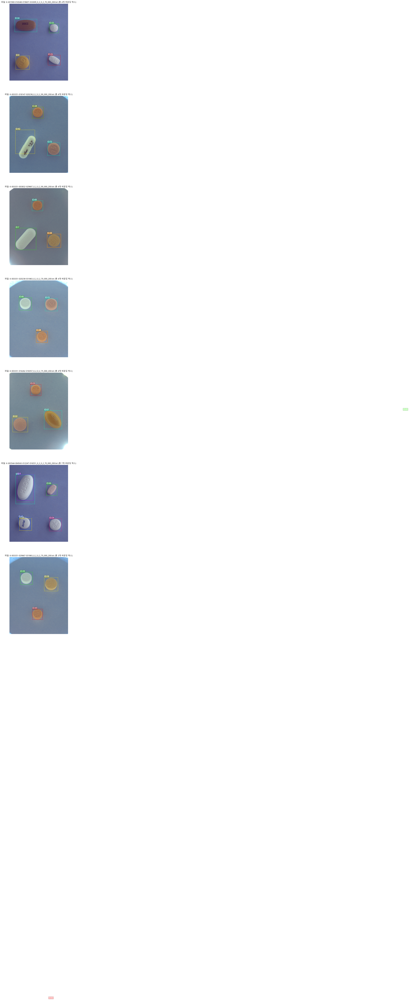

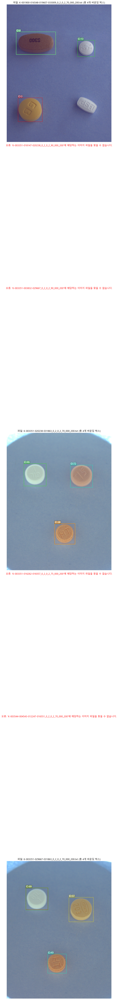

In [29]:
# 수정한 바운딩 박스 시각화
changed_bbox_files = [
    'K-001900-016548-019607-033009_0_2_0_2_70_000_200.txt',
    'K-003351-018147-020238_0_2_0_2_90_000_200.txt',
    'K-003351-003832-029667_0_2_0_2_90_000_200.txt',
    'K-003351-020238-031863_0_2_0_2_70_000_200.txt',
    'K-003351-016262-018357_0_2_0_2_75_000_200.txt',
    'K-003544-004543-012247-016551_0_2_0_2_70_000_200.txt',
    'K-003351-029667-031863_0_2_0_2_70_000_200.txt',
]


visualize_specific_overlapping_boxes(img_train_dir, lbl_train_dir, changed_bbox_files)
visualize_specific_overlapping_boxes(img_val_dir, lbl_val_dir, changed_bbox_files)

## 데이터 자체 전처리

- 라벨 누락 정책 통일
- 라벨이 없는 이미지는 빈 txt 생성(네거티브 유지) 또는 이미지 제외 중 하나를 일관 적용

In [31]:
# 데이터 전처리 감사/정리 유틸 
import os, json, math, hashlib
from pathlib import Path
from collections import Counter

DRY_RUN = True  # True면 수정하지 않고 리포트만 출력

# 경로 추정
try:
    yolo_root  # noqa
except NameError:
    yolo_root = None

if not yolo_root:
    # base_dir로부터 추정
    try:
        base_dir  # noqa
    except NameError:
        from pathlib import Path as _P
        # train_dir가 있다면 그 상위가 base_dir
        if 'train_dir' in globals():
            base_dir = _P(train_dir).parent
        else:
            base_dir = _P('./data')
    for cand in [os.path.join(str(base_dir), 'data_yolo'), os.path.join(os.path.dirname(str(base_dir)), 'data_yolo')]:
        if os.path.isdir(cand):
            yolo_root = cand; break

img_train_dir = os.path.join(yolo_root, 'images', 'train') if yolo_root else None
img_val_dir   = os.path.join(yolo_root, 'images', 'val')   if yolo_root else None
lbl_train_dir = os.path.join(yolo_root, 'labels', 'train') if yolo_root else None
lbl_val_dir   = os.path.join(yolo_root, 'labels', 'val')   if yolo_root else None

# YAML에서 클래스 수/이름 로드 시도
names = None
try:
    import yaml
    yaml_path = os.path.join(yolo_root, 'yolo_data.yaml') if yolo_root else None
    if yaml_path and os.path.exists(yaml_path):
        with open(yaml_path, 'r', encoding='utf-8') as f:
            data_yaml = yaml.safe_load(f)
        names = data_yaml.get('names')
        nc = int(data_yaml.get('nc', len(names) if names else 9999))
    else:
        nc = 9999
except Exception:
    nc = 9999

IMG_EXT = ('.png', '.jpg', '.jpeg')


def list_images(d):
    if not d or not os.path.isdir(d):
        return []
    return sorted([f for f in os.listdir(d) if f.lower().endswith(IMG_EXT)])


def audit_label_file(path, img_size=None, nc_hint=None):
    """한 개 라벨 파일 검사 및 정리 제안.
    반환: (유지할 라인 리스트, 통계 dict)
    """
    issues = []
    kept = []
    try:
        with open(path, 'r', encoding='utf-8') as f:
            lines = [ln.strip() for ln in f if ln.strip()]
    except Exception as e:
        return [], {'error': str(e), 'lines_in': 0, 'lines_kept': 0, 'issues': ['io_error']}

    for ln in lines:
        parts = ln.split()
        if len(parts) != 5:
            issues.append('format_err'); continue
        try:
            cid = int(parts[0])
            x, y, w, h = map(float, parts[1:])
        except Exception:
            issues.append('parse_err'); continue
        if nc_hint is not None and (cid < 0 or cid >= nc_hint):
            issues.append('cid_oob'); continue
        # 범위 검사 및 clamp
        x = min(max(x, 0.0), 1.0)
        y = min(max(y, 0.0), 1.0)
        w = min(max(w, 0.0), 1.0)
        h = min(max(h, 0.0), 1.0)
        if w <= 0.0 or h <= 0.0:
            issues.append('zero_area'); continue
        # 박스가 이미지 밖으로 크게 나간 경우는 clamp로 보정됨
        kept.append(f"{cid} {x:.6f} {y:.6f} {w:.6f} {h:.6f}")

    # 중복 라인 제거
    before = len(kept)
    kept = list(dict.fromkeys(kept))
    if len(kept) < before:
        issues.append('deduped')

    return kept, {'lines_in': len(lines), 'lines_kept': len(kept), 'issues': issues}


# 이미지 무결성/중복 검사(빠른 해시)
def file_sha1(path, max_bytes=1_000_000):
    try:
        h = hashlib.sha1()
        with open(path, 'rb') as f:
            chunk = f.read(max_bytes)
            h.update(chunk)
        return h.hexdigest()
    except Exception:
        return None


def audit_split(images_dir, labels_dir, split_name='train'):
    imgs = list_images(images_dir)
    miss, empty = [], []
    label_stats = []
    too_small_removed = 0
    label_paths_to_write = {}

    for img in imgs:
        base = os.path.splitext(img)[0]
        lpath = os.path.join(labels_dir, base + '.txt') if labels_dir else None
        if not lpath or not os.path.exists(lpath):
            miss.append(img)
            continue
        kept, stats = audit_label_file(lpath, img_size=None, nc_hint=nc)
        label_stats.append(stats)
        if stats.get('lines_in', 0) == 0:
            empty.append(img)
        # 너무 작은 박스(픽셀 기준) 필터링은 이미지 크기 알아야 정확, 여기선 YOLO norm 기준 0.002 미만 예시로 제거
        filtered = []
        for ln in kept:
            cid, x, y, w, h = ln.split()
            w = float(w); h = float(h)
            if w < 0.002 or h < 0.002:
                too_small_removed += 1
                continue
            filtered.append(ln)
        if not DRY_RUN:
            label_paths_to_write[lpath] = filtered

    # 적용 단계(옵션)
    if not DRY_RUN:
        for p, lines in label_paths_to_write.items():
            with open(p, 'w', encoding='utf-8') as f:
                f.write('\n'.join(lines) + ('\n' if lines else ''))

    # 요약
    total_imgs = len(imgs)
    kept_lines = sum(s.get('lines_kept', 0) for s in label_stats)
    in_lines = sum(s.get('lines_in', 0) for s in label_stats)
    issues_counter = Counter()
    for s in label_stats:
        for it in s.get('issues', []):
            issues_counter[it] += 1

    print(f"=== {split_name} 점검 요약 ===")
    print(f"- 이미지 수: {total_imgs}")
    print(f"- 라벨 없음: {len(miss)}")
    print(f"- 라벨 비어있음: {len(empty)}")
    print(f"- 라벨 총 라인수: in={in_lines}, kept={kept_lines}, 제거={in_lines-kept_lines}")
    print(f"- 너무 작은 박스 제거(0.002 기준): {too_small_removed}")
    print(f"- 이슈 카운트: {dict(issues_counter)}")
    if DRY_RUN:
        print("(DRY_RUN) 실제 파일은 수정하지 않았습니다.")

    return {
        'total_imgs': total_imgs,
        'miss': miss,
        'empty': empty,
        'issues': dict(issues_counter),
        'too_small_removed': too_small_removed,
        'in_lines': in_lines,
        'kept_lines': kept_lines,
    }


# 실행
if not yolo_root or not os.path.isdir(yolo_root):
    print('경고: YOLO 루트를 찾지 못했습니다. 먼저 변환/구성을 수행하세요.')
else:
    _ = audit_split(img_train_dir, lbl_train_dir, 'train')
    _ = audit_split(img_val_dir,   lbl_val_dir,   'val')

=== train 점검 요약 ===
- 이미지 수: 1437
- 라벨 없음: 0
- 라벨 비어있음: 0
- 라벨 총 라인수: in=5250, kept=5250, 제거=0
- 너무 작은 박스 제거(0.002 기준): 0
- 이슈 카운트: {}
(DRY_RUN) 실제 파일은 수정하지 않았습니다.
=== val 점검 요약 ===
- 이미지 수: 545
- 라벨 없음: 0
- 라벨 비어있음: 0
- 라벨 총 라인수: in=1985, kept=1985, 제거=0
- 너무 작은 박스 제거(0.002 기준): 0
- 이슈 카운트: {}
(DRY_RUN) 실제 파일은 수정하지 않았습니다.


In [27]:
"""
일단 라벨 이미지 대비 라벨이 누락 된 건이 있어서

네거티브 유지를 시켜서 누락 비율을 낮추는 방향으로 진행했습니다.

"""

'\n일단 라벨 이미지 대비 라벨이 누락 된 건이 있어서\n\n네거티브 유지를 시켜서 누락 비율을 낮추는 방향으로 진행했습니다.\n\n'

In [32]:
# 네거티브 유지: 라벨 누락 이미지에 빈 .txt 생성
import os

# 경로 보정
try:
    img_train_dir  # noqa: F821
    img_val_dir    # noqa: F821
    lbl_train_dir  # noqa: F821
    lbl_val_dir    # noqa: F821
except NameError:
    # yolo_root 추정
    yolo_root_found = None
    try:
        yolo_root  # noqa: F821
        yolo_root_found = yolo_root if os.path.isdir(yolo_root) else None
    except NameError:
        yolo_root_found = None
    if not yolo_root_found:
        # base_dir 기준으로 탐색
        try:
            base_dir  # noqa: F821
        except NameError:
            from pathlib import Path
            base_dir = Path('./data')
        cands = [
            os.path.join(str(base_dir), 'data_yolo'),
            os.path.join(os.path.dirname(str(base_dir)), 'data_yolo'),
        ]
        for c in cands:
            if os.path.isdir(c):
                yolo_root_found = c; break
    if not yolo_root_found:
        raise RuntimeError('data_yolo 경로를 찾지 못했습니다. 먼저 YOLO 변환을 수행하세요.')
    img_train_dir = os.path.join(yolo_root_found, 'images', 'train')
    img_val_dir   = os.path.join(yolo_root_found, 'images', 'val')
    lbl_train_dir = os.path.join(yolo_root_found, 'labels', 'train')
    lbl_val_dir   = os.path.join(yolo_root_found, 'labels', 'val')


def ensure_empty_labels(images_dir, labels_dir):
    created = []
    for img in os.listdir(images_dir):
        if not img.lower().endswith(('.png', '.jpg', '.jpeg')):
            continue
        base = os.path.splitext(img)[0]
        lbl_path = os.path.join(labels_dir, base + '.txt')
        if not os.path.exists(lbl_path):
            # 빈 파일 생성
            with open(lbl_path, 'w', encoding='utf-8') as f:
                f.write('')
            created.append(os.path.basename(lbl_path))
    return created

created_train = ensure_empty_labels(img_train_dir, lbl_train_dir)
created_val   = ensure_empty_labels(img_val_dir,   lbl_val_dir)

print(f'생성된 빈 라벨(train): {len(created_train)}개')
print(f'생성된 빈 라벨(val):   {len(created_val)}개')
if created_train:
    print('샘플(train):', created_train[:5])
if created_val:
    print('샘플(val):', created_val[:5])

생성된 빈 라벨(train): 0개
생성된 빈 라벨(val):   0개



## 클래스 불균형 개선


In [33]:
# 클래스 분포/가중치 산출 (저장 없음, 콘솔 미리보기)
import os, json
from collections import Counter

# 경로 및 names 로드
try:
    yolo_root  # noqa
except NameError:
    yolo_root = None
if not yolo_root or not os.path.isdir(yolo_root):
    # 최근에 사용한 yolo_root_found 활용
    try:
        yolo_root_found  # noqa
        if yolo_root_found and os.path.isdir(yolo_root_found):
            yolo_root = yolo_root_found
    except NameError:
        pass

if not yolo_root or not os.path.isdir(yolo_root):
    print('경고: yolo_root를 찾지 못해 클래스 가중치를 산출하지 않습니다.')
else:
    yaml_path = os.path.join(yolo_root, 'yolo_data.yaml')
    names = None
    if os.path.exists(yaml_path):
        import yaml
        with open(yaml_path, 'r', encoding='utf-8') as f:
            data_yaml = yaml.safe_load(f)
        names = data_yaml.get('names')
        nc = int(data_yaml.get('nc', len(names) if names else 0))
    else:
        nc = 0

    def read_labels(split_dir):
        cnt = Counter()
        if not os.path.isdir(split_dir):
            return cnt
        for f in os.listdir(split_dir):
            if not f.endswith('.txt'):
                continue
            p = os.path.join(split_dir, f)
            with open(p, 'r', encoding='utf-8') as fh:
                for ln in fh:
                    ln = ln.strip()
                    if not ln:
                        continue
                    try:
                        cid = int(ln.split()[0])
                        cnt[cid] += 1
                    except Exception:
                        continue
        return cnt

    tr_cnt = read_labels(os.path.join(yolo_root, 'labels', 'train'))
    va_cnt = read_labels(os.path.join(yolo_root, 'labels', 'val'))
    total_cnt = tr_cnt + va_cnt

    total_boxes = sum(total_cnt.values())
    print('총 박스 수:', total_boxes)
    if total_boxes == 0:
        print('라벨 박스가 없어 가중치를 계산하지 않습니다.')
    else:
        # inverse-frequency 기반 가중치 (합=nc가 되도록 정규화)
        import math
        weights = {}
        max_cid = max(total_cnt.keys()) if total_cnt else -1
        for cid in range(max_cid + 1):
            f = total_cnt.get(cid, 0)
            w = 1.0 / (f + 1e-6)
            weights[cid] = w
        s = sum(weights.values()) or 1.0
        for k in list(weights.keys()):
            weights[k] = weights[k] * (len(weights) / s)

        # 콘솔 미리보기만 (저장 없음)
        print('상위 등장 클래스:', total_cnt.most_common(5))
        print('하위 등장 클래스:', sorted(total_cnt.items(), key=lambda x: x[1])[:5])
        preview = {k: round(v, 4) for k, v in list(weights.items())[:10]}
        print('가중치 프리뷰(앞 10개):', preview)
        if names:
            print('클래스 이름 프리뷰:', {i: names[i] for i in range(min(10, len(names)))})

총 박스 수: 8398
상위 등장 클래스: [(50, 715), (29, 339), (3, 320), (0, 315), (15, 296)]
하위 등장 클래스: [(69, 29), (71, 32), (66, 39), (47, 39), (48, 40)]
가중치 프리뷰(앞 10개): {0: 0.2442, 1: 0.3645, 2: 1.3037, 3: 0.2404, 4: 0.3496, 5: 1.0988, 6: 1.3494, 7: 1.1833, 8: 1.2406, 9: 0.6009}


In [34]:
# 클래스 불균형 대응: 가중치 기반 oversampling 목록 생성
import os, json, math, statistics
from collections import Counter, defaultdict

# yolo_root 및 경로 복구
try:
    yolo_root  # noqa
except NameError:
    yolo_root = None
if not yolo_root or not os.path.isdir(yolo_root):
    try:
        yolo_root_found  # noqa
        if yolo_root_found and os.path.isdir(yolo_root_found):
            yolo_root = yolo_root_found
    except NameError:
        pass
if not yolo_root or not os.path.isdir(yolo_root):
    raise RuntimeError('yolo_root를 찾지 못해 oversampling을 진행할 수 없습니다. 먼저 YOLO 구성을 확인하세요.')

img_train_dir = os.path.join(yolo_root, 'images', 'train')
lbl_train_dir = os.path.join(yolo_root, 'labels', 'train')

# train 라벨 읽어 클래스 분포 집계
def read_train_labels(labels_dir):
    img_to_classes = defaultdict(list)  # 이미지 -> 등장 클래스 리스트(중복 허용)
    class_counts = Counter()
    if not os.path.isdir(labels_dir):
        return img_to_classes, class_counts
    for f in os.listdir(labels_dir):
        if not f.endswith('.txt'):
            continue
        path = os.path.join(labels_dir, f)
        with open(path, 'r', encoding='utf-8') as fh:
            for ln in fh:
                ln = ln.strip()
                if not ln:
                    continue
                try:
                    cid = int(ln.split()[0])
                except Exception:
                    continue
                img_to_classes[f].append(cid)
                class_counts[cid] += 1
    return img_to_classes, class_counts

img_to_classes, class_counts = read_train_labels(lbl_train_dir)

# inverse-frequency 기반 클래스 가중치 계산 (합=nc로 정규화)
if class_counts:
    max_cid = max(class_counts.keys())
    raw_weights = {}
    for cid in range(max_cid + 1):
        f = class_counts.get(cid, 0)
        raw_weights[cid] = 1.0 / (f + 1e-6)
    s = sum(raw_weights.values()) or 1.0
    class_weights = {k: (v * (len(raw_weights) / s)) for k, v in raw_weights.items()}
else:
    class_weights = {}

# 이미지별 가중치 산정
NEGATIVE_BASE = 0.5   # 빈 라벨(네거티브)의 기본 가중치

def image_weight(stem):
    cls_list = img_to_classes.get(stem + '.txt', [])
    if not cls_list:
        return NEGATIVE_BASE
    # 박스별 가중치 평균
    ws = [class_weights.get(c, 1.0) for c in cls_list]
    return sum(ws) / len(ws)

# 모든 train 이미지에 대해 weight 산출
def list_images(d):
    return [f for f in os.listdir(d) if f.lower().endswith(('.png','.jpg','.jpeg'))]

train_imgs = sorted(list_images(img_train_dir))
weights = []
for img in train_imgs:
    stem = os.path.splitext(img)[0]
    w = image_weight(stem)
    weights.append(w)

# 평균 1로 정규화 후 정수 반복 계수 산정
if weights:
    mean_w = statistics.mean(weights)
    norm_weights = [w / (mean_w if mean_w else 1.0) for w in weights]
else:
    norm_weights = []

MAX_REP = 5  # 최대 반복 제한
rep_factors = [max(1, min(MAX_REP, int(round(w)))) for w in norm_weights]

# 결과 목록 생성 및 저장
weighted_list = []
for img, r in zip(train_imgs, rep_factors):
    weighted_list.extend([os.path.join(img_train_dir, img)] * r)

out_path = os.path.join(yolo_root, 'train_weighted.txt')
with open(out_path, 'w', encoding='utf-8') as f:
    for p in weighted_list:
        f.write(p + '\n')

# 요약 출력
print('=== Oversampling 요약 ===')
print(f'- 원본 train 이미지 수: {len(train_imgs)}')
print(f'- 가중치 평균(정규화 전): {round(statistics.mean(weights), 4) if weights else "N/A"}')
print(f'- 정규화 후 평균(이론상 1): {round(statistics.mean([w for w in norm_weights]) ,4) if norm_weights else "N/A"}')
print(f'- 최대 반복 제한: {MAX_REP}x')
print(f'- 생성된 리스트 길이(학습 샘플 수): {len(weighted_list)}')
# 반복 분포
rep_hist = Counter(rep_factors)
print('- 반복 계수 분포:', dict(sorted(rep_hist.items())))
print('저장 위치:', out_path)

# 상위 oversample 후보 미리보기
top_idx = sorted(range(len(train_imgs)), key=lambda i: rep_factors[i], reverse=True)[:10]
preview = [(train_imgs[i], rep_factors[i], round(weights[i],4)) for i in top_idx]
print('상위 oversample 이미지(파일명, 반복, 원가중치):')
for p in preview:
    print('  ', p)

=== Oversampling 요약 ===
- 원본 train 이미지 수: 1437
- 가중치 평균(정규화 전): 0.6405
- 정규화 후 평균(이론상 1): 1.0
- 최대 반복 제한: 5x
- 생성된 리스트 길이(학습 샘플 수): 1597
- 반복 계수 분포: {1: 1279, 2: 156, 3: 2}
저장 위치: C:\Users\user\.vscode\pill-snap\data_yolo_test\train_weighted.txt
상위 oversample 이미지(파일명, 반복, 원가중치):
   ('K-002483-003743-004378-019552_0_2_0_2_70_000_200.png', 3, 1.7338)
   ('K-002483-003743-004378-019552_0_2_0_2_75_000_200.png', 3, 1.7338)
   ('K-001900-016548-018110-021026_0_2_0_2_70_000_200.png', 2, 1.3611)
   ('K-001900-016548-021026-021771_0_2_0_2_75_000_200.png', 2, 1.3961)
   ('K-001900-016548-029451-033208_0_2_0_2_90_000_200.png', 2, 1.0923)
   ('K-001900-016548-031705-044199_0_2_0_2_90_000_200.png', 2, 0.9667)
   ('K-001900-016551-018110-027926_0_2_0_2_75_000_200.png', 2, 0.9726)
   ('K-001900-016551-018110-027926_0_2_0_2_90_000_200.png', 2, 0.9726)
   ('K-001900-016551-019607-027926_0_2_0_2_70_000_200.png', 2, 1.0928)
   ('K-001900-016551-019607-029451_0_2_0_2_75_000_200.png', 2, 1.1912)


## 중복 이미지 체크

In [38]:
# 분할 누수(교집합) 체크: images/train vs images/val
import os
from pathlib import Path

# 경로 복구
try:
    yolo_root  # noqa
except NameError:
    yolo_root = None
if not yolo_root or not os.path.isdir(yolo_root):
    try:
        yolo_root_found  # noqa
        if yolo_root_found and os.path.isdir(yolo_root_found):
            yolo_root = yolo_root_found
    except NameError:
        pass

img_train_dir = os.path.join(yolo_root, 'images', 'train') if yolo_root else None
img_val_dir   = os.path.join(yolo_root, 'images', 'val')   if yolo_root else None

if not img_train_dir or not os.path.isdir(img_train_dir) or not img_val_dir or not os.path.isdir(img_val_dir):
    raise RuntimeError('images/train 또는 images/val 경로를 찾지 못했습니다.')

# stem 집합 생성
EXT = ('.png', '.jpg', '.jpeg')
train_stems = {os.path.splitext(f)[0] for f in os.listdir(img_train_dir) if f.lower().endswith(EXT)}
val_stems   = {os.path.splitext(f)[0] for f in os.listdir(img_val_dir)   if f.lower().endswith(EXT)}

inter = sorted(train_stems & val_stems)
print('=== 분할 누수 체크 ===')
print(f'- train 이미지 수: {len(train_stems)}')
print(f'- val   이미지 수: {len(val_stems)}')
print(f'- 교집합(stem 기준) 수: {len(inter)}')
if inter:
    print('샘플(최대 20개):', inter[:20])

=== 분할 누수 체크 ===
- train 이미지 수: 1437
- val   이미지 수: 545
- 교집합(stem 기준) 수: 493
샘플(최대 20개): ['K-001900-010224-016551-031705_0_2_0_2_75_000_200', 'K-001900-010224-016551-033009_0_2_0_2_70_000_200', 'K-001900-010224-016551-033009_0_2_0_2_75_000_200', 'K-001900-016548-018110-021026_0_2_0_2_70_000_200', 'K-001900-016548-018110-021026_0_2_0_2_75_000_200', 'K-001900-016548-018110-027926_0_2_0_2_70_000_200', 'K-001900-016548-018110-029345_0_2_0_2_75_000_200', 'K-001900-016548-018110-029345_0_2_0_2_90_000_200', 'K-001900-016548-018110-029451_0_2_0_2_70_000_200', 'K-001900-016548-018110-031705_0_2_0_2_70_000_200', 'K-001900-016548-018110-033009_0_2_0_2_75_000_200', 'K-001900-016548-018110-033009_0_2_0_2_90_000_200', 'K-001900-016548-019607-027926_0_2_0_2_90_000_200', 'K-001900-016548-019607-029345_0_2_0_2_70_000_200', 'K-001900-016548-019607-029451_0_2_0_2_90_000_200', 'K-001900-016548-019607-031705_0_2_0_2_75_000_200', 'K-001900-016548-019607-033009_0_2_0_2_70_000_200', 'K-001900-016548-019607-0

## 중복 되는 bbox

In [39]:
# NMS 기반 중복 박스 검사 
import os, math
from collections import defaultdict

IOU_THR = 0.5
APPLY = False  

# 경로 복구
try:
    yolo_root  # noqa
except NameError:
    yolo_root = None
if not yolo_root or not os.path.isdir(yolo_root):
    try:
        yolo_root_found  # noqa
        if yolo_root_found and os.path.isdir(yolo_root_found):
            yolo_root = yolo_root_found
    except NameError:
        pass

lbl_train_dir = os.path.join(yolo_root, 'labels', 'train') if yolo_root else None
lbl_val_dir   = os.path.join(yolo_root, 'labels', 'val')   if yolo_root else None

if not lbl_train_dir or not os.path.isdir(lbl_train_dir):
    raise RuntimeError('labels/train 경로를 찾지 못했습니다.')

# 유틸: IoU 계산 (YOLO norm 좌표 기준, 같은 이미지 가정)
def iou_yolo(a, b):
    # a,b: (cls, x, y, w, h) with center-based [0-1]
    _, ax, ay, aw, ah = a
    _, bx, by, bw, bh = b
    ax1, ay1 = ax - aw/2, ay - ah/2
    ax2, ay2 = ax + aw/2, ay + ah/2
    bx1, by1 = bx - bw/2, by - bh/2
    bx2, by2 = bx + bw/2, by + bh/2
    inter_w = max(0.0, min(ax2, bx2) - max(ax1, bx1))
    inter_h = max(0.0, min(ay2, by2) - max(ay1, by1))
    inter = inter_w * inter_h
    area_a = aw * ah
    area_b = bw * bh
    union = area_a + area_b - inter
    return inter / union if union > 0 else 0.0


def parse_label_line(ln):
    parts = ln.strip().split()
    if len(parts) != 5:
        return None
    try:
        cid = int(parts[0]); x,y,w,h = map(float, parts[1:])
    except Exception:
        return None
    return (cid, x, y, w, h)


def nms_per_class(boxes, iou_thr=0.6):
    # boxes: list of (cid,x,y,w,h)
    # 간단히 면적 큰 순 유지(NMS 스코어를 w*h로 대체)
    boxes_sorted = sorted(boxes, key=lambda b: (b[3]*b[4]), reverse=True)
    kept = []
    removed_idx = set()
    for i, bi in enumerate(boxes_sorted):
        if i in removed_idx:
            continue
        keep = True
        for kj, bj in enumerate(kept):
            if bi[0] != bj[0]:
                continue
            if iou_yolo(bi, bj) >= iou_thr:
                keep = False
                break
        if keep:
            kept.append(bi)
        else:
            removed_idx.add(i)
    return kept, len(boxes_sorted) - len(kept)

# 라벨 파일 순회
summary_removed = 0
affected_files = 0
per_file_stats = []

for split_name, ldir in [('train', lbl_train_dir), ('val', lbl_val_dir)]:
    if not os.path.isdir(ldir):
        continue
    for f in os.listdir(ldir):
        if not f.endswith('.txt'):
            continue
        path = os.path.join(ldir, f)
        try:
            with open(path, 'r', encoding='utf-8') as fh:
                lines = [ln.strip() for ln in fh if ln.strip()]
        except Exception:
            continue
        boxes = [parse_label_line(ln) for ln in lines]
        boxes = [b for b in boxes if b is not None]
        if not boxes:
            continue
        # 클래스별로 NMS
        by_cls = defaultdict(list)
        for b in boxes:
            by_cls[b[0]].append(b)
        kept_all = []
        removed = 0
        for cid, arr in by_cls.items():
            kept, rem = nms_per_class(arr, IOU_THR)
            kept_all.extend(kept)
            removed += rem
        if removed > 0:
            affected_files += 1
            summary_removed += removed
            per_file_stats.append((split_name, f, removed))
            if APPLY:
                with open(path, 'w', encoding='utf-8') as fw:
                    for b in kept_all:
                        cid,x,y,w,h = b
                        fw.write(f"{cid} {x:.6f} {y:.6f} {w:.6f} {h:.6f}\n")

print('=== NMS 중복 박스 감사 (DRY_RUN) ===')
print(f'- IoU 임계값: {IOU_THR}')
print(f'- 영향 받은 파일 수: {affected_files}')
print(f'- 제거 예상 박스 수 합계: {summary_removed}')
if per_file_stats:
    print('샘플(최대 20개):')
    for rec in per_file_stats[:20]:
        print('  ', rec)
if APPLY:
    print('(적용 모드) 파일이 덮어써졌습니다.')
else:
    print('(DRY_RUN) 파일은 수정하지 않았습니다.')

=== NMS 중복 박스 감사 (DRY_RUN) ===
- IoU 임계값: 0.5
- 영향 받은 파일 수: 0
- 제거 예상 박스 수 합계: 0
(DRY_RUN) 파일은 수정하지 않았습니다.


In [41]:
# 중복/손상 이미지 감사
import os, hashlib
from pathlib import Path
from collections import defaultdict
from PIL import Image

DRY_RUN = True
PARTIAL_BYTES = 128 * 1024  # 128KB
IMG_EXT = ('.png', '.jpg', '.jpeg')

# yolo_root 자동 탐색 유틸
def discover_yolo_root():
    # 1) 기존 변수 사용
    try:
        if 'yolo_root' in globals() and yolo_root and os.path.isdir(yolo_root):
            return yolo_root
    except Exception:
        pass
    try:
        if 'yolo_root_found' in globals() and yolo_root_found and os.path.isdir(yolo_root_found):
            return yolo_root_found
    except Exception:
        pass
    # 2) 흔한 경로 후보
    cands = [
        Path('./data/data_yolo'),
        Path('./data_yolo'),
    ]
    for c in cands:
        if (c / 'images' / 'train').is_dir() and (c / 'labels' / 'train').is_dir():
            return str(c)
    # 3) 재귀 탐색: ./data 및 현재 폴더 하위에서 data_yolo 찾기
    for base in [Path('./data'), Path('.')]:
        if not base.exists():
            continue
        for root, dirs, files in os.walk(base):
            if 'data_yolo' in dirs:
                yr = Path(root) / 'data_yolo'
                if (yr / 'images' / 'train').is_dir() and (yr / 'labels' / 'train').is_dir():
                    return str(yr)
    return None

# yolo_root 결정
yolo_root_auto = discover_yolo_root()
if not yolo_root_auto:
    print('경고: yolo_root를 자동으로 찾지 못했습니다. ./data 하위에 data_yolo가 있는지 확인하세요.')
    # 안전 종료: 작업을 스킵하되 크래시하지 않음
    print('스캔을 건너뜁니다(DRY_RUN).')
else:
    img_train_dir = os.path.join(yolo_root_auto, 'images', 'train')
    img_val_dir   = os.path.join(yolo_root_auto, 'images', 'val')

    def list_images(d):
        if not os.path.isdir(d):
            return []
        return [os.path.join(d, f) for f in os.listdir(d) if f.lower().endswith(IMG_EXT)]

    def sha1_partial(path, nbytes=PARTIAL_BYTES):
        try:
            h = hashlib.sha1()
            with open(path, 'rb') as f:
                chunk = f.read(nbytes)
                h.update(chunk)
            return h.hexdigest()
        except Exception:
            return None

    def sha1_full(path, buf_size=1024*1024):
        try:
            h = hashlib.sha1()
            with open(path, 'rb') as f:
                while True:
                    b = f.read(buf_size)
                    if not b:
                        break
                    h.update(b)
            return h.hexdigest()
        except Exception:
            return None

    def find_duplicates(paths):
        # 1차: (size, partial_hash) 그룹핑 → 2차: full_hash 확인
        by_size_partial = defaultdict(list)
        for p in paths:
            try:
                size = os.path.getsize(p)
            except Exception:
                size = -1
            ph = sha1_partial(p) if size > 0 else None
            by_size_partial[(size, ph)].append(p)

        dup_groups = []
        for (size, ph), group in by_size_partial.items():
            if size <= 0 or ph is None or len(group) < 2:
                continue
            # full hash로 확정
            by_full = defaultdict(list)
            for p in group:
                fh = sha1_full(p)
                if fh:
                    by_full[fh].append(p)
            for fh, g in by_full.items():
                if len(g) > 1:
                    dup_groups.append(sorted(g))
        return dup_groups

    def find_damaged(paths):
        damaged = []
        for p in paths:
            try:
                with Image.open(p) as im:
                    im.verify()  # 파일 손상 여부 확인(픽셀 로드 X)
            except Exception:
                damaged.append(p)
        return damaged

    # 스캔 대상 수집
    train_imgs = list_images(img_train_dir)
    val_imgs   = list_images(img_val_dir)
    all_imgs   = train_imgs + val_imgs

    print('=== 중복/손상 이미지 감사 (DRY_RUN) ===')
    print(f'- yolo_root: {yolo_root_auto}')
    print(f'- 스캔 대상: train {len(train_imgs)}장, val {len(val_imgs)}장, 합계 {len(all_imgs)}장')

    # 중복 탐지
    dup_groups = find_duplicates(all_imgs)
    dup_total = sum(len(g)-1 for g in dup_groups)  # 각 그룹 대표 1장 제외한 개수
    print(f'- 중복 그룹 수: {len(dup_groups)}')
    print(f'- 중복 파일 수(대표 제외): {dup_total}')
    if dup_groups:
        print('중복 그룹 샘플(최대 3개 그룹):')
        for g in dup_groups[:3]:
            print('  -', os.path.basename(g[0]), '외', len(g)-1, '개 더')

    # 손상 탐지
    bad = find_damaged(all_imgs)
    print(f'- 손상 파일 수: {len(bad)}')
    if bad:
        print('손상 샘플(최대 10개):')
        for p in bad[:10]:
            print('  -', p)

    if DRY_RUN:
        print('(DRY_RUN) 파일 변경은 수행하지 않았습니다.')

=== 중복/손상 이미지 감사 (DRY_RUN) ===
- yolo_root: C:\Users\user\.vscode\pill-snap\data_yolo_test
- 스캔 대상: train 1437장, val 545장, 합계 1982장
- 중복 그룹 수: 493
- 중복 파일 수(대표 제외): 493
중복 그룹 샘플(최대 3개 그룹):
  - K-001900-010224-016551-031705_0_2_0_2_75_000_200.png 외 1 개 더
  - K-001900-010224-016551-033009_0_2_0_2_70_000_200.png 외 1 개 더
  - K-001900-010224-016551-033009_0_2_0_2_75_000_200.png 외 1 개 더
- 손상 파일 수: 0
(DRY_RUN) 파일 변경은 수행하지 않았습니다.


In [42]:
# 블러(흐림) 스코어 계산: NameError 방지용 자동 구성 포함
import os
import cv2
import numpy as np
from pathlib import Path

try:
    from tqdm import tqdm
except Exception:
    def tqdm(x, **kwargs):
        return x

# yolo_root 자동 탐지
def discover_yolo_root():
    try:
        if 'yolo_root' in globals() and yolo_root and os.path.isdir(yolo_root):
            return yolo_root
    except Exception:
        pass
    try:
        if 'yolo_root_found' in globals() and yolo_root_found and os.path.isdir(yolo_root_found):
            return yolo_root_found
    except Exception:
        pass
    for c in [Path('./data/data_yolo'), Path('./data_yolo')]:
        if (c / 'images' / 'train').is_dir():
            return str(c)
    for base in [Path('./data'), Path('.')]:
        if not base.exists():
            continue
        for root, dirs, files in os.walk(base):
            if 'data_yolo' in dirs:
                yr = Path(root) / 'data_yolo'
                if (yr / 'images' / 'train').is_dir():
                    return str(yr)
    return None

yr = discover_yolo_root()
if not yr:
    raise RuntimeError('data_yolo를 찾지 못했습니다. 먼저 YOLO 데이터 구성을 완료하세요.')

img_train_dir = os.path.join(yr, 'images', 'train')
img_val_dir   = os.path.join(yr, 'images', 'val')

# img_files 자동 구성 (train + val)
IMG_EXT = ('.png', '.jpg', '.jpeg')
img_files = []
for d in [img_train_dir, img_val_dir]:
    if os.path.isdir(d):
        for f in os.listdir(d):
            if f.lower().endswith(IMG_EXT):
                img_files.append(os.path.join(d, f))

print(f'스코어링 대상 이미지: {len(img_files)}장')

# Laplacian variance 기반 블러 스코어
# 값이 작을수록 더 흐릿함

def blur_score(path):
    try:
        img = cv2.imdecode(np.fromfile(path, dtype=np.uint8), cv2.IMREAD_GRAYSCALE)
        if img is None:
            return None
        lap = cv2.Laplacian(img, cv2.CV_64F)
        return float(lap.var())
    except Exception:
        return None

N = 30  # 하위 N (가장 흐린 이미지)
scores = []
for p in tqdm(img_files, desc='Blur scoring'):
    s = blur_score(p)
    if s is not None:
        scores.append((p, s))

scores.sort(key=lambda x: x[1])
print('계산된 스코어 개수:', len(scores))
print('가장 흐린 상위 N개:')
for p, s in scores[:N]:
    print(f'{s:10.4f}  {p}')

스코어링 대상 이미지: 1982장


Blur scoring:   0%|          | 0/1982 [00:00<?, ?it/s]

Blur scoring: 100%|██████████| 1982/1982 [00:50<00:00, 39.23it/s]

계산된 스코어 개수: 1982
가장 흐린 상위 N개:
   24.5159  C:\Users\user\.vscode\pill-snap\data_yolo_test\images\train\K-002483-013395-023223-025438_0_2_0_2_75_000_200.png
   24.5570  C:\Users\user\.vscode\pill-snap\data_yolo_test\images\train\K-002483-012081-023223-025438_0_2_0_2_75_000_200.png
   24.6230  C:\Users\user\.vscode\pill-snap\data_yolo_test\images\train\K-002483-013395-019552-025438_0_2_0_2_75_000_200.png
   24.6764  C:\Users\user\.vscode\pill-snap\data_yolo_test\images\train\K-002483-013395-022627-025438_0_2_0_2_75_000_200.png
   24.6764  C:\Users\user\.vscode\pill-snap\data_yolo_test\images\val\K-002483-013395-022627-025438_0_2_0_2_75_000_200.png
   24.8755  C:\Users\user\.vscode\pill-snap\data_yolo_test\images\train\K-002483-006192-013395-025438_0_2_0_2_75_000_200.png
   24.9094  C:\Users\user\.vscode\pill-snap\data_yolo_test\images\train\K-002483-012778-013395-025438_0_2_0_2_75_000_200.png
   24.9533  C:\Users\user\.vscode\pill-snap\data_yolo_test\images\train\K-002483-022362-023223-02

시각화 대상 개수: 16


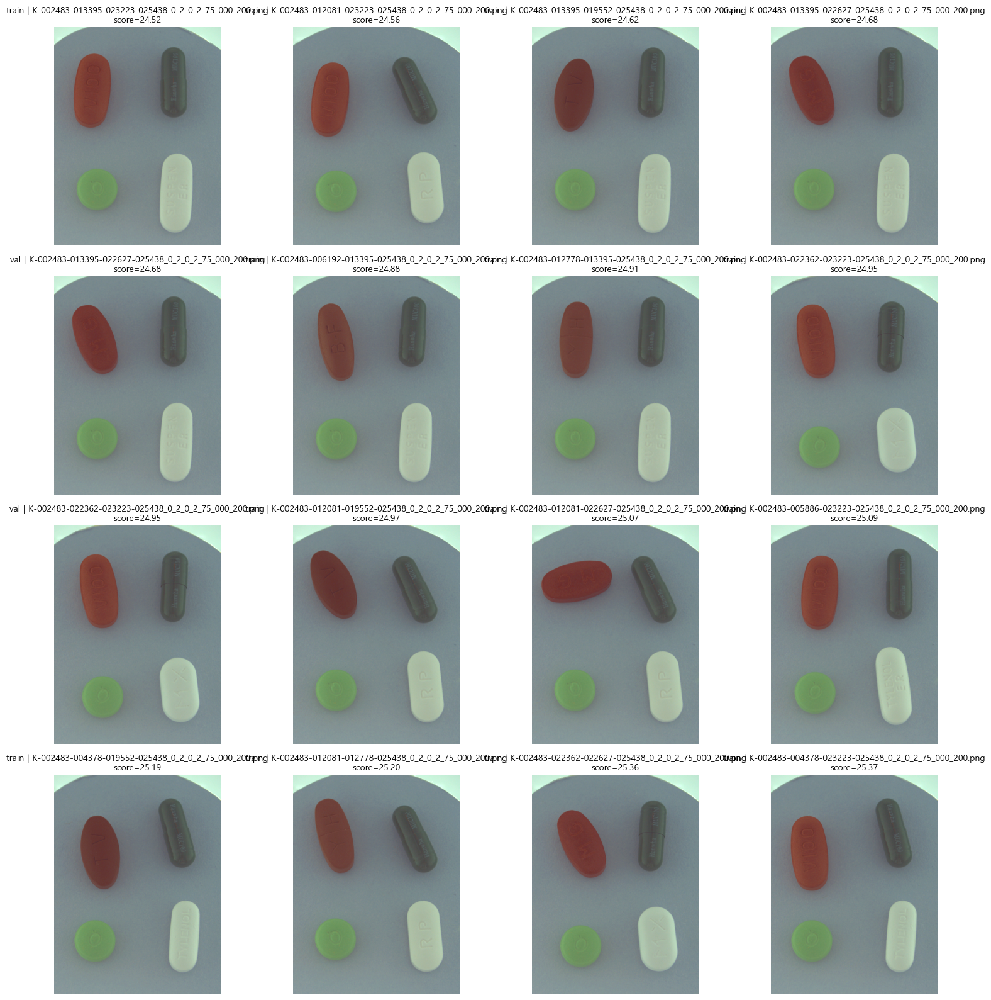

In [43]:
# 흐린 이미지 TOP K 시각화 (scores 미존재 시 자동 산출)
import os, math
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# 안전한 tqdm 대체
try:
    from tqdm import tqdm
except Exception:
    def tqdm(x, **kwargs):
        return x

# blur_score / 데이터 탐지 유틸이 없으면 정의
try:
    blur_score  # noqa
except NameError:
    import cv2
    def blur_score(path):
        try:
            img = cv2.imdecode(np.fromfile(path, dtype=np.uint8), cv2.IMREAD_GRAYSCALE)
            if img is None:
                return None
            lap = cv2.Laplacian(img, cv2.CV_64F)
            return float(lap.var())
        except Exception:
            return None

try:
    img_files  # noqa
except NameError:
    # yolo_root 탐지 후 img_files 구성
    from pathlib import Path
    def discover_yolo_root():
        try:
            if 'yolo_root' in globals() and yolo_root and os.path.isdir(yolo_root):
                return yolo_root
        except Exception:
            pass
        try:
            if 'yolo_root_found' in globals() and yolo_root_found and os.path.isdir(yolo_root_found):
                return yolo_root_found
        except Exception:
            pass
        for c in [Path('./data/data_yolo'), Path('./data_yolo')]:
            if (c / 'images' / 'train').is_dir():
                return str(c)
        for base in [Path('./data'), Path('.')]:
            if not base.exists():
                continue
            for root, dirs, files in os.walk(base):
                if 'data_yolo' in dirs:
                    yr = Path(root) / 'data_yolo'
                    if (yr / 'images' / 'train').is_dir():
                        return str(yr)
        return None
    yr = discover_yolo_root()
    if not yr:
        raise RuntimeError('data_yolo를 찾지 못했습니다. 먼저 YOLO 데이터 구성을 완료하세요.')
    img_train_dir = os.path.join(yr, 'images', 'train')
    img_val_dir   = os.path.join(yr, 'images', 'val')
    IMG_EXT = ('.png', '.jpg', '.jpeg')
    img_files = []
    for d in [img_train_dir, img_val_dir]:
        if os.path.isdir(d):
            for f in os.listdir(d):
                if f.lower().endswith(IMG_EXT):
                    img_files.append(os.path.join(d, f))

# scores 미존재 또는 비어있으면 재산출
try:
    scores  # noqa
    if not isinstance(scores, list) or len(scores) == 0:
        raise NameError
except Exception:
    tmp_scores = []
    for p in tqdm(img_files, desc='Re-scoring (blur)'):
        s = blur_score(p)
        if s is not None:
            tmp_scores.append((p, s))
    tmp_scores.sort(key=lambda x: x[1])
    scores = tmp_scores

# 시각화 파라미터
K = 16  # 보여줄 개수
cols = 4
rows = math.ceil(min(K, len(scores)) / cols) if scores else 1

print(f'시각화 대상 개수: {min(K, len(scores)) if scores else 0}')

if not scores:
    print('경고: 시각화할 스코어가 없습니다.')
else:
    fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 4*rows))
    if rows == 1 and cols == 1:
        axes = np.array([[axes]])
    elif rows == 1:
        axes = np.array([axes])

    subset = scores[:min(K, len(scores))]
    for idx, (p, s) in enumerate(subset):
        r = idx // cols
        c = idx % cols
        ax = axes[r, c]
        try:
            img = Image.open(p).convert('RGB')
            ax.imshow(img)
        except Exception:
            ax.text(0.5, 0.5, '이미지 로드 실패', ha='center', va='center')
        base = os.path.basename(p)
        split = 'train' if (os.sep+'train'+os.sep) in p else ('val' if (os.sep+'val'+os.sep) in p else '')
        ax.set_title(f'{split} | {base}\nscore={s:.2f}', fontsize=10)
        ax.axis('off')

    # 빈 칸 처리
    total_axes = rows * cols
    for j in range(len(subset), total_axes):
        r = j // cols
        c = j % cols
        axes[r, c].axis('off')

    plt.tight_layout()
    plt.show()

## 흐린 이미지 라벨 개선


클래스 수: 73
이미지 개수: train=1437, val=545, total=1982
기존 blur scores 재사용(정규화 적용)
선택된 K(흐림): 16


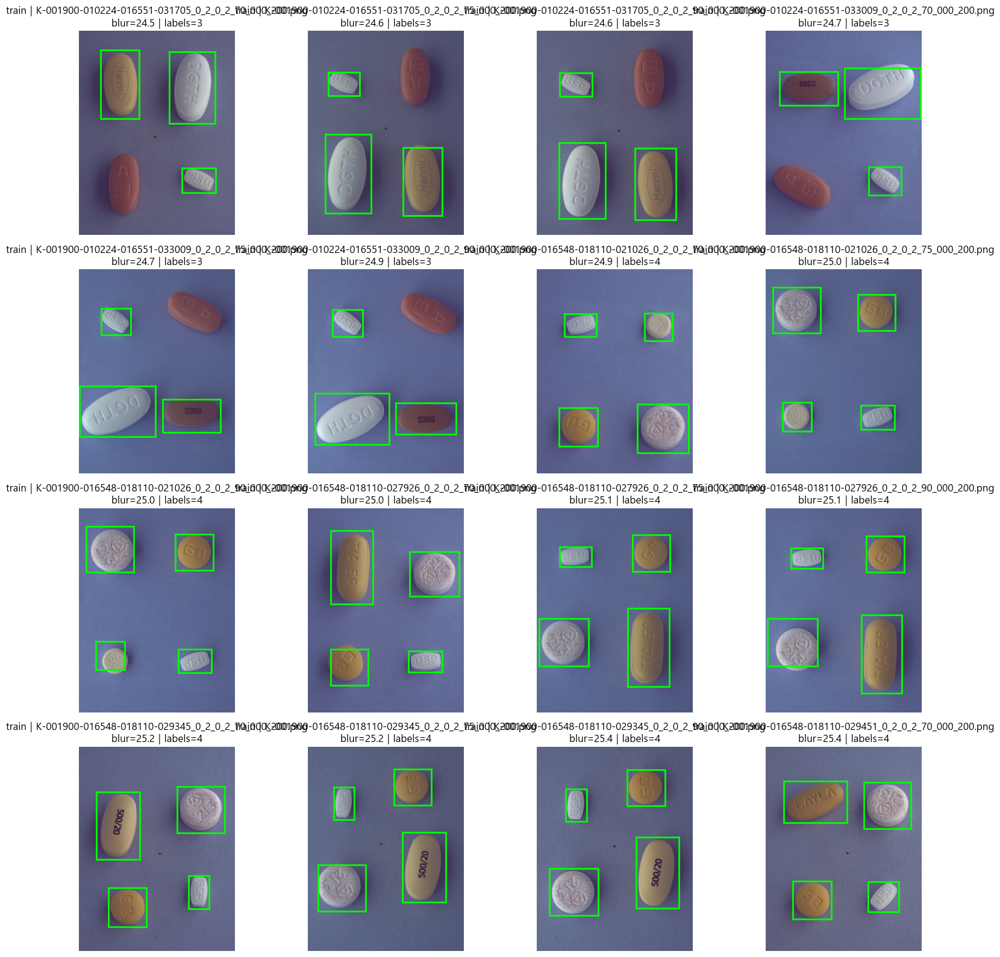

표시 이미지 수: 16, 네거티브 수: 0


In [44]:
# ...existing code...

# YOLO 라벨 오버레이: blur score 상위(가장 흐린) K개를 그리드로 시각화 (yolo_data_test.yaml 반영)
import os, math, glob, yaml, random
from pathlib import Path
from collections import defaultdict
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt

# 시드 고정
random.seed(42); np.random.seed(42)

# 0) YAML 경로 고정(프로젝트 구조 기준)
try:
    NB  # 노트북 루트가 이미 있다면 사용
except Exception:
    NB = Path.cwd()

YAML_PATH = (NB.parent / 'configs' / 'yolo_data_test.yaml').resolve()  # pill-snap/configs/yolo_data_test.yaml
if not YAML_PATH.is_file():
    raise FileNotFoundError(f'YAML을 찾지 못했습니다: {YAML_PATH}')

# 1) YAML 로딩 및 경로/클래스 확보
with open(YAML_PATH, 'r', encoding='utf-8') as f:
    data = yaml.safe_load(f)

names = data.get('names')
if isinstance(names, dict):
    names = [v for k, v in sorted(names.items(), key=lambda kv: int(k))]
assert isinstance(names, (list, tuple)), 'YAML의 names는 리스트/튜플이어야 합니다.'
names = list(names)
nc = len(names)
print(f'클래스 수: {nc}')

yaml_dir = YAML_PATH.parent
# train/val 이미지 디렉토리 절대경로로 변환 (YAML 상대경로를 configs 기준으로 해석)
img_train_dir = str((yaml_dir / data['train']).resolve())
img_val_dir   = str((yaml_dir / data['val']).resolve())

# yolo_root 추정(…/images/train 의 상위 2단계)
yolo_root = str(Path(img_train_dir).parents[1])

# 라벨 디렉토리 구성
lbl_train_dir = str(Path(yolo_root) / 'labels' / Path(img_train_dir).name)  # labels/train
lbl_val_dir   = str(Path(yolo_root) / 'labels' / Path(img_val_dir).name)    # labels/val

IMG_EXT = ('.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff')

train_imgs = [p for p in glob.glob(os.path.join(img_train_dir, '**', '*'), recursive=True) if p.lower().endswith(IMG_EXT)]
val_imgs   = [p for p in glob.glob(os.path.join(img_val_dir,   '**', '*'), recursive=True) if p.lower().endswith(IMG_EXT)]
all_imgs   = train_imgs + val_imgs
print(f'이미지 개수: train={len(train_imgs)}, val={len(val_imgs)}, total={len(all_imgs)}')

# 2) blur score 계산/재사용
def compute_blur_score(img_path):
    try:
        img = cv2.imdecode(np.fromfile(img_path, dtype=np.uint8), cv2.IMREAD_GRAYSCALE)
        if img is None:
            return float('inf')  # 읽기 실패는 최상위로 보내지 않도록 큰 값
        return cv2.Laplacian(img, cv2.CV_64F).var()
    except Exception:
        return float('inf')

def score_value(x):
    if isinstance(x, (int, float)) and not isinstance(x, bool):
        return float(x)
    if isinstance(x, (list, tuple)):
        for t in x:
            if isinstance(t, (int, float)) and not isinstance(t, bool):
                return float(t)
    if isinstance(x, dict):
        for k in ('score','blur','var','val','value'):
            v = x.get(k, None)
            if isinstance(v, (int, float)) and not isinstance(v, bool):
                return float(v)
    return float('inf')

try:
    scores  # noqa: F821
    norm_scores = [score_value(s) for s in scores]
    if len(norm_scores) != len(all_imgs):
        raise AssertionError
    print('기존 blur scores 재사용(정규화 적용)')
except Exception:
    print('blur scores 미발견/불일치 → 계산 진행')
    norm_scores = [compute_blur_score(p) for p in all_imgs]

# 3) 상위 K개(가장 흐림) 선택
K = globals().get('K', 12)
pairs = list(zip(all_imgs, norm_scores))
pairs_sorted = sorted(pairs, key=lambda x: (x[1], os.path.basename(x[0])))  # 점수 오름차순=흐림
topK = pairs_sorted[:min(K, len(pairs_sorted))]
print('선택된 K(흐림):', len(topK))

# 4) 라벨 로더(YOLO 형식)
def load_yolo_labels_for_image(img_path, img_train_dir, img_val_dir, lbl_train_dir, lbl_val_dir):
    img_path = os.path.normpath(img_path)
    img_train_dir = os.path.normpath(img_train_dir)
    img_val_dir   = os.path.normpath(img_val_dir)

    # split 판별 + 상대경로 계산
    sp = None; rel = None
    try:
        common = os.path.commonpath([img_path, img_train_dir])
    except Exception:
        common = ''
    if common == img_train_dir:
        sp = 'train'
        rel = os.path.relpath(img_path, img_train_dir)
        lbl_dir = lbl_train_dir
    else:
        try:
            common = os.path.commonpath([img_path, img_val_dir])
        except Exception:
            common = ''
        if common == img_val_dir:
            sp = 'val'
            rel = os.path.relpath(img_path, img_val_dir)
            lbl_dir = lbl_val_dir
        else:
            return []

    stem = os.path.splitext(rel)[0]
    lbl_path = os.path.join(lbl_dir, stem + '.txt')
    if not os.path.isfile(lbl_path):
        return []
    boxes = []
    try:
        with open(lbl_path, 'r', encoding='utf-8') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                cls = int(parts[0]); x, y, w, h = map(float, parts[1:])
                boxes.append((cls, x, y, w, h))
    except Exception:
        return []
    return boxes

# 5) 시각화
def draw_boxes(ax, img_bgr, boxes, names, show_label=False):
    h, w = img_bgr.shape[:2]
    for (cls, xc, yc, bw, bh) in boxes:
        x = (xc - bw/2.0) * w
        y = (yc - bh/2.0) * h
        ww = bw * w
        hh = bh * h
        x1,y1,x2,y2 = max(0,int(x)), max(0,int(y)), min(w-1,int(x+ww)), min(h-1,int(y+hh))
        rect = plt.Rectangle((x1, y1), x2 - x1, y2 - y1, fill=False, color='lime', linewidth=2)
        ax.add_patch(rect)
        if show_label:
            label = names[cls] if 0 <= cls < len(names) else str(cls)
            ax.text(x1, max(0, y1-2), label, color='black', fontsize=8,
                    bbox=dict(facecolor='yellow', alpha=0.7, edgecolor='none', pad=1.0))

cols = 4
rows = math.ceil(len(topK) / cols) if len(topK) else 1
fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 4*rows))
axes = np.array(axes).reshape(rows, cols) if isinstance(axes, np.ndarray) else np.array([[axes]])

negatives = 0
for idx, (img_path, sc) in enumerate(topK):
    r = idx // cols; c = idx % cols
    ax = axes[r, c]
    # Windows 경로에서 한글/공백 대비 imdecode 사용
    img_bgr = cv2.imdecode(np.fromfile(img_path, dtype=np.uint8), cv2.IMREAD_COLOR)
    if img_bgr is None:
        ax.axis('off'); ax.set_title(f'로드 실패\n{os.path.basename(img_path)}')
        continue
    boxes = load_yolo_labels_for_image(img_path, img_train_dir, img_val_dir, lbl_train_dir, lbl_val_dir)
    if len(boxes) == 0:
        negatives += 1
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    ax.imshow(img_rgb)
    draw_boxes(ax, img_bgr, boxes, names, show_label=False)  # 텍스트 숨김(옵션)

    # 제목(blur score, split, 라벨 수)
    sp = 'train' if os.path.commonpath([os.path.normpath(img_path), os.path.normpath(img_train_dir)]) == os.path.normpath(img_train_dir) \
         else 'val' if os.path.commonpath([os.path.normpath(img_path), os.path.normpath(img_val_dir)]) == os.path.normpath(img_val_dir) else '?'
    sc_float = score_value(sc)
    ax.set_title(f'{sp} | {os.path.basename(img_path)}\nblur={sc_float:.1f} | labels={len(boxes)}')
    ax.axis('off')

# 빈 칸 숨김
total_axes = rows * cols
for t in range(len(topK), total_axes):
    r = t // cols; c = t % cols
    axes[r, c].axis('off')

plt.tight_layout()
plt.show()
print(f'표시 이미지 수: {len(topK)}, 네거티브 수: {negatives}')

# ...existing code...

## 선명도 향상(시각화)

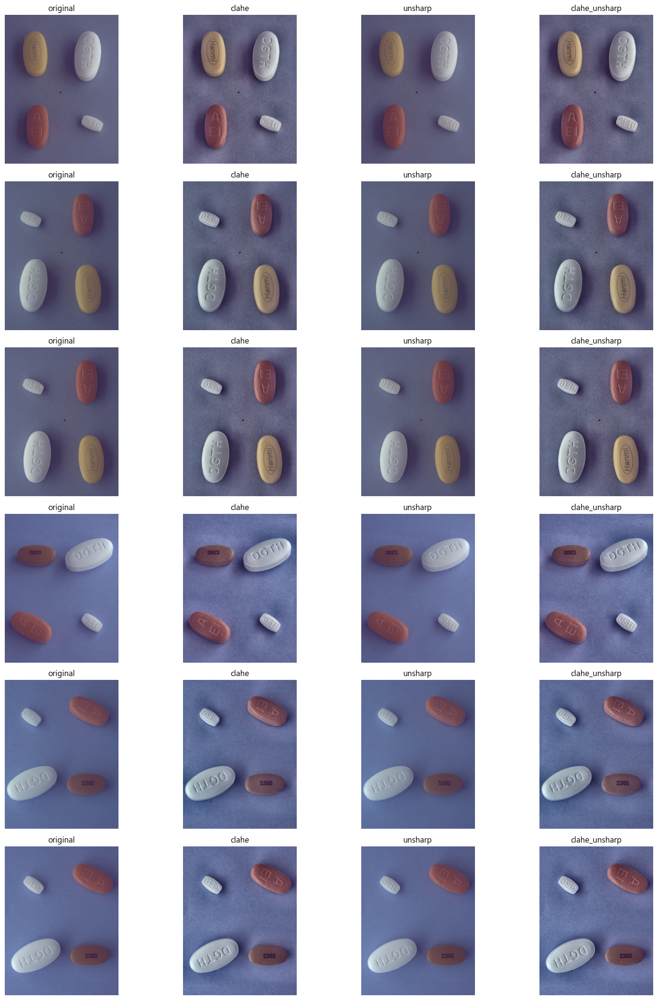

향상 비교 완료: 샘플 6장 × 모드 4개


In [45]:
# 선명도 향상: CLAHE, Unsharp, CLAHE→Unsharp 비교 시각화
import cv2, numpy as np, os, math, matplotlib.pyplot as plt

# 파라미터(필요시 조정)
CLAHE_CLIP = 2.0
CLAHE_TILE = (8, 8)
UNSHARP_AMOUNT = 1.2  # 강도(>1.0)
UNSHARP_RADIUS = 1.2  # 가우시안 블러 시그마
UNSHARP_THRESHOLD = 2  # 차이 임계(0~255)

def apply_clahe_rgb(img_bgr, clip=CLAHE_CLIP, tile=CLAHE_TILE):
    lab = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=clip, tileGridSize=tile)
    l2 = clahe.apply(l)
    lab2 = cv2.merge([l2, a, b])
    return cv2.cvtColor(lab2, cv2.COLOR_LAB2BGR)

def unsharp_mask_bgr(img_bgr, amount=UNSHARP_AMOUNT, radius=UNSHARP_RADIUS, threshold=UNSHARP_THRESHOLD):
    # 가우시안 블러
    blurred = cv2.GaussianBlur(img_bgr, (0,0), radius)
    # 차이
    diff = cv2.absdiff(img_bgr, blurred)
    # 임계 이하 차이는 0으로
    if threshold > 0:
        mask = cv2.cvtColor(diff, cv2.COLOR_BGR2GRAY)
        _, mask_bin = cv2.threshold(mask, threshold, 255, cv2.THRESH_BINARY)
        mask_bin = cv2.cvtColor(mask_bin, cv2.COLOR_GRAY2BGR)
        sharp = cv2.addWeighted(img_bgr, 1 + amount, blurred, -amount, 0)
        out = np.where(mask_bin>0, sharp, img_bgr)
        out = out.astype(np.uint8)
    else:
        out = cv2.addWeighted(img_bgr, 1 + amount, blurred, -amount, 0)
    return out

def enhance_pipeline(img_bgr, mode='clahe'):
    if mode == 'clahe':
        return apply_clahe_rgb(img_bgr)
    elif mode == 'unsharp':
        return unsharp_mask_bgr(img_bgr)
    elif mode == 'clahe_unsharp':
        return unsharp_mask_bgr(apply_clahe_rgb(img_bgr))
    else:
        return img_bgr

# 대상: 방금 선택한 topK(가장 흐린 이미지) 중 앞에서부터 최대 6장만 샘플
samples = topK[:min(6, len(topK))] if 'topK' in globals() else []
modes = ['original', 'clahe', 'unsharp', 'clahe_unsharp']
cols = len(modes) if len(modes) else 1
rows = len(samples) if len(samples) else 1
fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 3.5*rows))
if rows == 1 and cols == 1:
    axes = np.array([[axes]])
elif rows == 1:
    axes = np.array([axes])
elif cols == 1:
    axes = np.array([[a] for a in axes])

for r, (img_path, sc) in enumerate(samples):
    img_bgr = cv2.imdecode(np.fromfile(img_path, dtype=np.uint8), cv2.IMREAD_COLOR)
    for c, mode in enumerate(modes):
        ax = axes[r, c]
        if mode == 'original':
            shown = img_bgr
        else:
            shown = enhance_pipeline(img_bgr, mode)
        img_rgb = cv2.cvtColor(shown, cv2.COLOR_BGR2RGB)
        ax.imshow(img_rgb)
        if c == 0:
            ax.set_ylabel(os.path.basename(img_path), fontsize=9)
        ax.set_title(mode)
        ax.axis('off')

plt.tight_layout()
plt.show()
print(f"향상 비교 완료: 샘플 {len(samples)}장 × 모드 {len(modes)}개")

In [46]:
# ...existing code...

# YOLO 라벨 오버레이: blur score 상위(가장 흐린) K개를 그리드로 시각화 (YAML 우선, notebooks/data 폴백)
import os, math, glob, yaml, random
from pathlib import Path
import numpy as np
import cv2
import matplotlib.pyplot as plt

random.seed(42); np.random.seed(42)

# 경로/클래스 로더: configs/yolo_data_test.yaml 우선, 없으면 notebooks/data/data_yolo_test 사용
def load_data_dirs_and_names():
    NB = Path.cwd()
    yaml_path = (NB.parent / 'configs' / 'yolo_data_test.yaml').resolve()
    names = None

    if yaml_path.is_file():
        with open(yaml_path, 'r', encoding='utf-8') as f:
            data = yaml.safe_load(f)
        names = data.get('names')
        if isinstance(names, dict):
            names = [v for k, v in sorted(names.items(), key=lambda kv: int(k))]
        assert isinstance(names, (list, tuple)), 'YAML의 names는 리스트/튜플이어야 합니다.'
        yaml_dir = yaml_path.parent
        img_train_dir = str((yaml_dir / data['train']).resolve())
        img_val_dir   = str((yaml_dir / data['val']).resolve())
        yolo_root = str(Path(img_train_dir).parents[1])  # .../data_yolo_test
        lbl_train_dir = os.path.join(yolo_root, 'labels', 'train')
        lbl_val_dir   = os.path.join(yolo_root, 'labels', 'val')
        return img_train_dir, img_val_dir, lbl_train_dir, lbl_val_dir, list(names)

    # 폴백: notebooks/data/data_yolo_test
    default_root = (NB / 'data' / 'data_yolo_test').resolve()
    img_train_dir = str(default_root / 'images' / 'train')
    img_val_dir   = str(default_root / 'images' / 'val')
    lbl_train_dir = str(default_root / 'labels' / 'train')
    lbl_val_dir   = str(default_root / 'labels' / 'val')
    return img_train_dir, img_val_dir, lbl_train_dir, lbl_val_dir, None

img_train_dir, img_val_dir, lbl_train_dir, lbl_val_dir, names = load_data_dirs_and_names()
print('img_train_dir:', img_train_dir)
print('img_val_dir  :', img_val_dir)
print('lbl_train_dir:', lbl_train_dir)
print('lbl_val_dir  :', lbl_val_dir)
if names is not None:
    print('클래스 수:', len(names))

IMG_EXT = ('.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff')
train_imgs = [p for p in glob.glob(os.path.join(img_train_dir, '**', '*'), recursive=True) if p.lower().endswith(IMG_EXT)]
val_imgs   = [p for p in glob.glob(os.path.join(img_val_dir,   '**', '*'), recursive=True) if p.lower().endswith(IMG_EXT)]
all_imgs   = train_imgs + val_imgs
print(f'이미지 개수: train={len(train_imgs)}, val={len(val_imgs)}, total={len(all_imgs)}')

def compute_blur_score(img_path):
    try:
        img = cv2.imdecode(np.fromfile(img_path, dtype=np.uint8), cv2.IMREAD_GRAYSCALE)
        if img is None:
            return float('inf')
        return cv2.Laplacian(img, cv2.CV_64F).var()
    except Exception:
        return float('inf')

def score_value(x):
    if isinstance(x, (int, float)) and not isinstance(x, bool):
        return float(x)
    if isinstance(x, (list, tuple)):
        for t in x:
            if isinstance(t, (int, float)) and not isinstance(t, bool):
                return float(t)
    if isinstance(x, dict):
        for k in ('score','blur','var','val','value'):
            v = x.get(k, None)
            if isinstance(v, (int, float)) and not isinstance(v, bool):
                return float(v)
    return float('inf')

try:
    scores  # noqa: F821
    norm_scores = [score_value(s) for s in scores]
    if len(norm_scores) != len(all_imgs):
        raise AssertionError
    print('기존 blur scores 재사용(정규화 적용)')
except Exception:
    print('blur scores 미발견/불일치 → 계산 진행')
    norm_scores = [compute_blur_score(p) for p in all_imgs]

K = globals().get('K', 12)
pairs = list(zip(all_imgs, norm_scores))
pairs_sorted = sorted(pairs, key=lambda x: (x[1], os.path.basename(x[0])))
topK = pairs_sorted[:min(K, len(pairs_sorted))]
print('선택된 K(흐림):', len(topK))

def load_yolo_labels_for_image(img_path):
    ip = os.path.normpath(img_path)
    tr = os.path.normpath(img_train_dir)
    va = os.path.normpath(img_val_dir)
    lbl_dir = None
    if os.path.commonpath([ip, tr]) == tr:
        rel = os.path.relpath(ip, tr)
        lbl_dir = lbl_train_dir
    elif os.path.commonpath([ip, va]) == va:
        rel = os.path.relpath(ip, va)
        lbl_dir = lbl_val_dir
    else:
        return []
    stem = os.path.splitext(rel)[0]
    lbl_path = os.path.join(lbl_dir, stem + '.txt')
    if not os.path.isfile(lbl_path):
        return []
    boxes = []
    with open(lbl_path, 'r', encoding='utf-8') as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) != 5:
                continue
            cls = int(parts[0]); x, y, w, h = map(float, parts[1:])
            boxes.append((cls, x, y, w, h))
    return boxes

def draw_boxes(ax, img_bgr, boxes, names_, show_label=False):
    h, w = img_bgr.shape[:2]
    for (cls, xc, yc, bw, bh) in boxes:
        x = (xc - bw/2.0) * w
        y = (yc - bh/2.0) * h
        ww = bw * w
        hh = bh

img_train_dir: C:\Users\user\.vscode\pill-snap\data_yolo_test\images\train
img_val_dir  : C:\Users\user\.vscode\pill-snap\data_yolo_test\images\val
lbl_train_dir: C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\train
lbl_val_dir  : C:\Users\user\.vscode\pill-snap\data_yolo_test\labels\val
클래스 수: 73
이미지 개수: train=1437, val=545, total=1982
기존 blur scores 재사용(정규화 적용)
선택된 K(흐림): 16


In [47]:
# ...existing code...

# [sharpness-compare] Laplacian variance for original/clahe/unsharp/clahe_unsharp (YAML 우선, notebooks/data 폴백)
import os, glob, math, random
import numpy as np
import cv2

try:
    import pandas as pd
except Exception:
    pd = None

random.seed(42); np.random.seed(42)
N = 8
CLAHE_CLIP = 2.0
CLAHE_TILE = (8, 8)
UNSHARP_AMOUNT = 1.2
UNSHARP_RADIUS = 1.2
UNSHARP_THRESHOLD = 2

from pathlib import Path
import yaml

def dirs_from_yaml_or_default():
    NB = Path.cwd()
    yaml_path = (NB.parent / 'configs' / 'yolo_data_test.yaml').resolve()
    if yaml_path.is_file():
        with open(yaml_path, 'r', encoding='utf-8') as f:
            data = yaml.safe_load(f)
        yaml_dir = yaml_path.parent
        img_train_dir = str((yaml_dir / data['train']).resolve())
        img_val_dir   = str((yaml_dir / data['val']).resolve())
        return img_train_dir, img_val_dir
    root = (NB / 'data' / 'data_yolo_test').resolve()
    return str(root / 'images' / 'train'), str(root / 'images' / 'val')

img_train_dir, img_val_dir = dirs_from_yaml_or_default()
IMG_EXT = ('.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff')

all_imgs = [p for p in glob.glob(os.path.join(img_train_dir, '**', '*'), recursive=True) if p.lower().endswith(IMG_EXT)]
all_imgs += [p for p in glob.glob(os.path.join(img_val_dir,   '**', '*'), recursive=True) if p.lower().endswith(IMG_EXT)]

def apply_clahe_rgb(img_bgr, clip=CLAHE_CLIP, tile=CLAHE_TILE):
    lab = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2LAB)
    l,a,b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=clip, tileGridSize=tile)
    l2 = clahe.apply(l)
    lab2 = cv2.merge([l2,a,b])
    return cv2.cvtColor(lab2, cv2.COLOR_LAB2BGR)

def unsharp_mask_bgr(img_bgr, amount=UNSHARP_AMOUNT, radius=UNSHARP_RADIUS, threshold=UNSHARP_THRESHOLD):
    blurred = cv2.GaussianBlur(img_bgr, (0,0), radius)
    diff = cv2.absdiff(img_bgr, blurred)
    if threshold > 0:
        mask = cv2.cvtColor(diff, cv2.COLOR_BGR2GRAY)
        _, mask_bin = cv2.threshold(mask, threshold, 255, cv2.THRESH_BINARY)
        mask_bin = cv2.cvtColor(mask_bin, cv2.COLOR_GRAY2BGR)
        sharp = cv2.addWeighted(img_bgr, 1 + amount, blurred, -amount, 0)
        out = np.where(mask_bin>0, sharp, img_bgr).astype(np.uint8)
    else:
        out = cv2.addWeighted(img_bgr, 1 + amount, blurred, -amount, 0)
    return out

def enhance_pipeline(img_bgr, mode='clahe_unsharp'):
    if mode == 'clahe':
        return apply_clahe_rgb(img_bgr)
    if mode == 'unsharp':
        return unsharp_mask_bgr(img_bgr)
    if mode == 'clahe_unsharp':
        return unsharp_mask_bgr(apply_clahe_rgb(img_bgr))
    return img_bgr

def sharpness_laplacian(img_bgr):
    gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
    return float(cv2.Laplacian(gray, cv2.CV_64F).var())

if not all_imgs:
    print('[sharpness-compare] 비교할 이미지가 없습니다.')
else:
    subset = all_imgs[:N] if len(all_imgs) >= N else all_imgs
    rows = []
    for ip in subset:
        img_bgr = cv2.imdecode(np.fromfile(ip, dtype=np.uint8), cv2.IMREAD_COLOR)
        if img_bgr is None:
            continue
        s_orig    = sharpness_laplacian(img_bgr)
        s_clahe   = sharpness_laplacian(apply_clahe_rgb(img_bgr))
        s_unsharp = sharpness_laplacian(unsharp_mask_bgr(img_bgr))
        s_cu      = sharpness_laplacian(enhance_pipeline(img_bgr, 'clahe_unsharp'))

        def pct(delta, base): return (delta/base*100.0) if base > 0 else float('nan')
        rows.append({
            'image': os.path.basename(ip),
            'orig': s_orig, 'clahe': s_clahe, 'unsharp': s_unsharp, 'clahe_unsharp': s_cu,
            'improve_clahe_%': pct(s_clahe - s_orig, s_orig),
            'improve_unsharp_%': pct(s_unsharp - s_orig, s_orig),
            'improve_cu_%': pct(s_cu - s_orig, s_orig),
        })

    if not rows:
        print('[sharpness-compare] 유효 이미지가 없습니다.')
    else:
        if pd is not None:
            import pandas as _pd
            df = _pd.DataFrame(rows)
            for col in ['orig','clahe','unsharp','clahe_unsharp','improve_clahe_%','improve_unsharp_%','improve_cu_%']:
                df[col] = df[col].astype(float).round(2)
            print(df.sort_values('improve_cu_%', ascending=False).to_string(index=False))
            avg_scores = df[['orig','clahe','unsharp','clahe_unsharp']].mean().round(2)
            avg_improve = df[['improve_clahe_%','improve_unsharp_%','improve_cu_%']].mean().round(2)
            print('\n평균 선명도:', avg_scores.to_dict())
            print('평균 개선율(%):', avg_improve.to_dict())
        else:
            for r in rows:
                print(f"{r['image']}: orig={r['orig']:.2f}, clahe={r['clahe']:.2f}, unsharp={r['unsharp']:.2f}, cu={r['clahe_unsharp']:.2f} | "
                      f"Δclahe={r['improve_clahe_%']:.1f}%, Δunsharp={r['improve_unsharp_%']:.1f}%, Δcu={r['improve_cu_%']:.1f}%")
            o  = np.mean([r['orig'] for r in rows]); c  = np.mean([r['clahe'] for r in rows])
            u  = np.mean([r['unsharp'] for r in rows]); cu = np.mean([r['clahe_unsharp'] for r in rows])
            print(f"\n평균 선명도: orig={o:.2f}, clahe={c:.2f}, unsharp={u:.2f}, cu={cu:.2f}")
            def avg_imp(key):
                xs = [r[key] for r in rows if not math.isnan(r[key])]
                return float(np.mean(xs)) if xs else float('nan')
            print(f"평균 개선율(%%): clahe={avg_imp('improve_clahe_%'):.1f}, unsharp={avg_imp('improve_unsharp_%'):.1f}, cu={avg_imp('improve_cu_%'):.1f}")

# ...existing code...

                                               image  orig  clahe  unsharp  clahe_unsharp  improve_clahe_%  improve_unsharp_%  improve_cu_%
K-001900-016548-018110-021026_0_2_0_2_70_000_200.png 38.57 321.49   129.65        1458.78           733.45             236.11       3681.82
K-001900-016548-018110-021026_0_2_0_2_75_000_200.png 36.10 298.45   109.76        1355.89           726.76             204.06       3656.02
K-001900-010224-016551-033009_0_2_0_2_75_000_200.png 36.85 297.77   111.42        1351.64           708.04             202.35       3567.92
K-001900-010224-016551-031705_0_2_0_2_75_000_200.png 41.51 337.63   129.29        1512.67           713.43             211.48       3544.42
K-001900-010224-016551-033009_0_2_0_2_90_000_200.png 48.17 386.08   176.86        1748.04           701.51             267.16       3529.01
K-001900-010224-016551-031705_0_2_0_2_70_000_200.png 47.43 376.70   155.77        1693.81           694.15             228.40       3470.86
K-001900-010224-0165

==========================================================================================================

In [53]:
import os, json, random, shutil
from collections import defaultdict
from pathlib import Path

origin_dir = '..'

img_dir = os.path.join(origin_dir, 'data/train_images')
anno_dir = os.path.join(origin_dir, 'data/train_annotations_test')

# 새 YOLO용 경로
yolo_root = os.path.join(origin_dir, 'data_yolo_test')
img_train_dir = os.path.join(yolo_root, 'images/train')
img_val_dir = os.path.join(yolo_root, 'images/val')
lbl_train_dir = os.path.join(yolo_root, 'labels/train')
lbl_val_dir = os.path.join(yolo_root, 'labels/val')

for d in [img_train_dir, img_val_dir, lbl_train_dir, lbl_val_dir]:
    os.makedirs(d, exist_ok=True)

# -----------------------
# 1) 모든 json 모으기
# -----------------------
json_files = []
for root, _, files in os.walk(anno_dir):
    for f in files:
        if f.endswith('.json'):
            json_files.append(os.path.join(root, f))
print('총 JSON 개수:', len(json_files))

# -----------------------
# 2) 전역 class_map (name → id)
# -----------------------
class_map = {}
class_counter = 0
for jf in json_files:
    with open(jf, 'r', encoding='utf-8') as f:
        data = json.load(f)
    for cat in data.get('categories', []):
        name = cat['name']
        if name not in class_map:
            class_map[name] = class_counter
            class_counter += 1
print('클래스 개수:', len(class_map))

# -----------------------
# 3) 이미지별 json 묶기
# -----------------------
img2json = defaultdict(list)
for jf in json_files:
    with open(jf, 'r', encoding='utf-8') as f:
        data = json.load(f)
    img_name = data['images'][0]['file_name']
    img2json[img_name].append(jf)
print('총 이미지 개수:', len(img2json))

# -----------------------
# 4) YOLO txt 변환 함수
# -----------------------
def convert_jsons_to_txt(json_list, save_dir, class_map):
    if not json_list: return None
    with open(json_list[0], 'r', encoding='utf-8') as f:
        first_data = json.load(f)
    img = first_data['images'][0]
    img_w, img_h = img['width'], img['height']
    img_name = img['file_name']
    label_path = os.path.join(save_dir, img_name.replace('.png', '.txt'))

    yolo_lines = []
    for jf in json_list:
        with open(jf, 'r', encoding='utf-8') as f:
            data = json.load(f)
        id2name = {cat['id']: cat['name'] for cat in data['categories']}
        for ann in data['annotations']:
            if 'bbox' not in ann or len(ann['bbox']) != 4:
                continue
            x, y, w, h = ann['bbox']
            x_center = (x + w / 2) / img_w
            y_center = (y + h / 2) / img_h
            w /= img_w
            h /= img_h

            cat_id = ann['category_id']
            if cat_id not in id2name:
                continue
            name = id2name[cat_id]
            if name not in class_map:
                continue
            cls_id = class_map[name]

            yolo_lines.append(f'{cls_id} {x_center} {y_center} {w} {h}')
            if yolo_lines:
               with open(label_path, 'w', encoding='utf-8') as f:
                  f.write('\n'.join(yolo_lines) + '\n')
    return img_name

# -----------------------
# 5) Split train/val
# -----------------------
images = list(img2json.keys())
random.shuffle(images)
split_idx = int(len(images) * 0.8)
train_imgs, val_imgs = images[:split_idx], images[split_idx:]

print('Train 이미지:', len(train_imgs))
print('Val 이미지:', len(val_imgs))

# -----------------------
# 6) 변환 및 심볼릭 링크 생성
# -----------------------
def symlink(src, dst):
    try:
        os.symlink(src, dst)   # Unix/Linux
    except (AttributeError, OSError):
        # Windows나 권한 문제일 때 fallback
        shutil.copy(src, dst)

# train set
for img_name in train_imgs:
    img_src = os.path.join(img_dir, img_name)
    img_dst = os.path.join(img_train_dir, img_name)

    if not os.path.exists(img_src):
        print(f"⚠️ 이미지 없음, 스킵: {img_name}")
        continue

    if not os.path.exists(img_dst):
        symlink(img_src, img_dst)

    convert_jsons_to_txt(img2json[img_name], lbl_train_dir, class_map)

# val set
for img_name in val_imgs:
    img_src = os.path.join(img_dir, img_name)
    img_dst = os.path.join(img_val_dir, img_name)

    if not os.path.exists(img_src):
        print(f"⚠️ 이미지 없음, 스킵: {img_name}")
        continue 
    if not os.path.exists(img_dst):
        symlink(img_src, img_dst)

    convert_jsons_to_txt(img2json[img_name], lbl_val_dir, class_map)

print('YOLO data_yolo 준비 완료 ✅')
print('data_yolo_test/images/train:', len(os.listdir(img_train_dir)))
print('data_yolo_test/labels/train:', len(os.listdir(lbl_train_dir)))

총 JSON 개수: 5461
클래스 개수: 73
총 이미지 개수: 1494
Train 이미지: 1195
Val 이미지: 299
⚠️ 이미지 없음, 스킵: K-003351-013900-016688_0_2_0_2_90_000_200.png
⚠️ 이미지 없음, 스킵: K-003351-016232-018357_0_2_0_2_70_000_200.png
⚠️ 이미지 없음, 스킵: K-003483-016262-027733-031885_0_2_0_2_90_000_200.png
⚠️ 이미지 없음, 스킵: K-003351-019232-029667_0_2_1_2_75_000_200.png
⚠️ 이미지 없음, 스킵: K-003483-016262-019861-034597_0_2_0_2_70_000_200.png
YOLO data_yolo 준비 완료 ✅
data_yolo_test/images/train: 1437
data_yolo_test/labels/train: 1486


In [54]:
# =========================
# [실제 데이터셋 이미지 선명도 보정 및 덮어쓰기]
# =========================
import cv2
import numpy as np
import glob
import os

# enhance_pipeline 함수가 이미 위에서 정의되어 있어야 합니다.
def enhance_and_overwrite_images(img_dir, mode='clahe_unsharp', img_exts=('.jpg', '.jpeg', '.png')):
    img_paths = []
    for ext in img_exts:
        img_paths.extend(glob.glob(os.path.join(img_dir, f'**/*{ext}'), recursive=True))
    print(f"[선명도 보정] {img_dir} 내 이미지 {len(img_paths)}개 처리 시작")
    for img_path in img_paths:
        img_bgr = cv2.imdecode(np.fromfile(img_path, dtype=np.uint8), cv2.IMREAD_COLOR)
        if img_bgr is None:
            print(f"  ⚠️ 이미지 로드 실패: {img_path}")
            continue
        enhanced = enhance_pipeline(img_bgr, mode=mode)
        ext = os.path.splitext(img_path)[1].lower()
        result, buf = cv2.imencode(ext, enhanced)
        if result:
            buf.tofile(img_path)
        else:
            print(f"  ⚠️ 저장 실패: {img_path}")
    print(f"[선명도 보정] {img_dir} 내 모든 이미지 보정 및 덮어쓰기 완료")

# 실제 적용 (train/val 모두)
enhance_and_overwrite_images(img_train_dir, mode='clahe_unsharp')
enhance_and_overwrite_images(img_val_dir, mode='clahe_unsharp')

print("[완료] YOLO 데이터셋 이미지가 선명도 보정된 상태로 저장되었습니다.")

[선명도 보정] ..\data_yolo_test\images/train 내 이미지 1437개 처리 시작
[선명도 보정] ..\data_yolo_test\images/train 내 모든 이미지 보정 및 덮어쓰기 완료
[선명도 보정] ..\data_yolo_test\images/val 내 이미지 545개 처리 시작
[선명도 보정] ..\data_yolo_test\images/val 내 모든 이미지 보정 및 덮어쓰기 완료
[완료] YOLO 데이터셋 이미지가 선명도 보정된 상태로 저장되었습니다.


In [56]:
import os

try:
    label_root = os.path.dirname(lbl_train_dir)
except NameError:
    # 직접 지정 필요
    label_root = '/path/to/your/labels'  # 실제 경로로 수정
class_ids = set()

for split in ['train', 'val']:
    split_dir = os.path.join(label_root, split)
    for f in os.listdir(split_dir):
        if f.endswith('.txt'):
            with open(os.path.join(split_dir, f), 'r', encoding='utf-8') as ftxt:
                for line in ftxt:
                    cls_id = int(line.split()[0])
                    class_ids.add(cls_id)

print('클래스 개수:', len(class_ids))
print('클래스 ID 목록:', sorted(class_ids))

클래스 개수: 73
클래스 ID 목록: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72]


In [59]:
import yaml

yaml_path = '../configs/yolo_data_test.yaml'

data_yaml = {
    'train': '../data_yolo_test/images/train',
    'val': '../data_yolo_test/images/val',
    'nc': len(class_map),
    'names': [name for name, _ in sorted(class_map.items(), key=lambda x: x[1])]
}

with open(yaml_path, 'w', encoding='utf-8') as f:
    yaml.dump(data_yaml, f, allow_unicode=True)

print(f'yaml 저장 완료 → {yaml_path}')

yaml 저장 완료 → ../configs/yolo_data_test.yaml
